# SMART BILLING TEST:

Overview : We use an AI-based approach for retail billing, significantly reducing retail checkout times. Our model accurately detects multiple objects simultaneously, instantly generating bills at the click of a button. Customer satisfaction is vastly improved, leading to better sales, as they no longer need to wait for each item to be manually scanned before the bill is generated.

We use an object detection model based on the Faster RCNN architecture to detect items from an image of the checkout counter.This notebook contains steps to test the object detector.


---



Below is a link to a folder containeing validation data and a trained model : 

https://drive.google.com/drive/folders/10L1PLtX46ANJJ_RafmIREqSmqkeRz6_4?usp=sharing

To use it , please do add it to your drive.


## Installing detectron2 and other dependencies

In [7]:
# install dependencies: (use cu100 because colab is on CUDA 10.0)
!pip install -U torch==1.4+cu100 torchvision==0.5+cu100 -f https://download.pytorch.org/whl/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/torch_stable.html
Requirement already up-to-date: torch==1.4+cu100 in /home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages (1.4.0+cu100)
Requirement already up-to-date: torchvision==0.5+cu100 in /home/ec2-user/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages (0.5.0+cu100)
You should consider upgrading via the '/home/ec2-user/anaconda3/envs/pytorch_p36/bin/python -m pip install --upgrade pip' command.
Processing /home/ec2-user/.cache/pip/wheels/cb/b2/f5/ca72754568a333674fd4758f5d5674f88431e58fb9837cc565/PyYAML-5.1-cp36-cp36m-linux_x86_64.whl
ERROR: fastai 1.0.61 requires nvidia-ml-py3, which is not installed.
ERROR: detectron2 0.2.1+cu100 has requirement pycocotools>=2.0.1, but you'll have pycocotools 2.0 which is incompatible.
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 5.3.1
ERROR: Cannot uninstall 'PyYAML'. It is a distutils installed project and thus we cannot accurately determine wh

In [8]:
# install detectron2:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html
Processing /home/ec2-user/.cache/pip/wheels/3f/ef/f8/0335de365305b04082b274251f59bdc6805238a9fe33cc17ae/pycocotools-2.0.1-cp36-cp36m-linux_x86_64.whl
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0
You should consider upgrading via the '/home/ec2-user/anaconda3/envs/pytorch_p36/bin/python -m pip install --upgrade pip' command.


In [9]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os
import cv2
import random
import json

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

## Uploading data to S3

---
We will upload the data to S3 bucket **'retail-checkout-data'**

### This section of cells has been run to upload the data. Do not run them again during testing.

In [5]:
## Extracting the testdata
from zipfile import ZipFile

with ZipFile(os.path.join('testdata2019.zip'),'r') as zipObj:
    zipObj.extractall()
os.rename('val2019','testdata2019')

"\nfrom zipfile import ZipFile\n\nwith ZipFile(os.path.join('testdata2019.zip'),'r') as zipObj:\n    zipObj.extractall()\nos.rename('val2019','testdata2019')\n\n"

In [26]:
# Setting up the bucket

import boto3, re, sys, math, json, os, sagemaker, urllib.request
from sagemaker import get_execution_role

# Define IAM role
role = get_execution_role()
containers = {'us-west-2': '433757028032.dkr.ecr.us-west-2.amazonaws.com/xgboost:latest',
              'us-east-1': '811284229777.dkr.ecr.us-east-1.amazonaws.com/xgboost:latest',
              'us-east-2': '825641698319.dkr.ecr.us-east-2.amazonaws.com/xgboost:latest',
              'eu-west-1': '685385470294.dkr.ecr.eu-west-1.amazonaws.com/xgboost:latest'} # each region has its XGBoost container
my_region = boto3.session.Session().region_name # set the region of the instance
print("Success - the MySageMakerInstance is in the " + my_region + " region. You will use the " + containers[my_region] + " container for your SageMaker endpoint.")

bucket_name = 'retail-checkout-data'
s3 = boto3.resource('s3')
try:
    if  my_region == 'us-east-1':
      s3.create_bucket(Bucket=bucket_name)
    else: 
      s3.create_bucket(Bucket=bucket_name, CreateBucketConfiguration={'LocationConstraint': my_region})
    print('S3 bucket created successfully')
except Exception as e:
    print('S3 error: ',e)

Success - the MySageMakerInstance is in the us-east-1 region. You will use the 811284229777.dkr.ecr.us-east-1.amazonaws.com/xgboost:latest container for your SageMaker endpoint.
S3 bucket created successfully


### Uploading all the test images in the directory testdata2019 in the s3 bucket retail-checkout

In [28]:
s3_client = boto3.client('s3')

def uploadDirectory(path,bucketname):
    for root,dirs,files in os.walk(path):
        for file in files:
            print(file)
            s3_client.upload_file(os.path.join(root,file),bucketname,'testdata2019/'+file)
            
uploadDirectory('testdata2019',bucket_name)

20181016-13-47-29-1796.jpg
20180907-10-58-01-576.jpg
20180920-13-12-58-1186.jpg
20180921-09-20-16-1271.jpg
20180828-10-27-25-801.jpg
20180903-15-25-41-3056.jpg
20181019-10-48-56-2681.jpg
20181018-17-19-16-2631.jpg
20180829-15-07-07-1791.jpg
20180928-09-55-01-2251.jpg
20180921-13-26-33-1486.jpg
20181009-17-09-24-3071.jpg
20181009-13-54-53-2816.jpg
20181018-10-47-26-2851.jpg
20181025-09-33-04-161.jpg
20180829-16-33-56-1421.jpg
20181009-15-50-00-2841.jpg
20181024-15-37-31-136.jpg
20180927-15-39-56-2206.jpg
20181016-09-38-01-1591.jpg
20180830-15-47-20-2021.jpg
20180829-09-52-25-1211.jpg
20180907-15-19-29-716.jpg
20180910-14-03-00-936.jpg
20180830-11-21-16-1521.jpg
20180917-13-40-33-906.jpg
20180903-14-57-21-2646.jpg
20180829-16-59-01-1431.jpg
20180831-16-38-45-2886.jpg
20181019-14-38-55-2736.jpg
20180910-15-22-51-31.jpg
20181016-10-57-58-1816.jpg
20180919-11-04-03-1071.jpg
20180913-15-45-20-631.jpg
20181017-11-16-41-1961.jpg
20181025-16-01-05-186.jpg
20181019-15-06-29-2466.jpg
20180911-17-

20180905-14-02-55-151.jpg
20181017-13-19-11-2126.jpg
20180913-11-55-27-501.jpg
20181016-11-08-34-1821.jpg
20180918-10-02-03-1011.jpg
20180830-16-35-21-2256.jpg
20180827-10-38-13-571.jpg
20180831-15-54-40-2856.jpg
20181010-13-48-24-3126.jpg
20180928-11-50-09-2276.jpg
20180910-13-19-15-1.jpg
20180925-13-56-34-1611.jpg
20181018-15-16-52-2916.jpg
20181025-11-13-53-76.jpg
20180828-14-21-17-906.jpg
20181018-15-37-13-2926.jpg
20180904-10-46-49-3166.jpg
20180827-09-38-46-546.jpg
20180903-09-57-39-2951.jpg
20181018-13-34-28-2356.jpg
20180918-15-25-16-1066.jpg
20181025-09-55-58-26.jpg
20181011-15-38-50-1256.jpg
20181010-13-43-53-2911.jpg
20180907-09-57-03-636.jpg
20180905-15-26-36-186.jpg
20180827-15-27-58-721.jpg
20181019-11-38-25-2416.jpg
20180824-16-37-43-71.jpg
20181010-15-42-00-2941.jpg
20180831-09-21-23-2081.jpg
20180904-13-41-20-3211.jpg
20180827-13-07-09-611.jpg
20181009-16-34-37-3061.jpg
20180917-13-55-03-911.jpg
20181016-16-45-37-2051.jpg
20181015-10-33-19-1631.jpg
20181018-09-29-32-22

20181023-17-12-14-56.jpg
20180913-14-44-38-616.jpg
20181023-09-52-46-3136.jpg
20181017-11-07-52-1956.jpg
20181019-15-50-17-2766.jpg
20180929-10-10-19-2351.jpg
20181024-14-11-59-121.jpg
20180903-14-40-51-2631.jpg
20181023-13-44-05-3181.jpg
20180912-14-04-50-321.jpg
20180927-10-50-23-1766.jpg
20180929-11-11-09-2166.jpg
20180928-14-59-08-2101.jpg
20180907-10-58-13-576.jpg
20181011-17-02-41-3271.jpg
20181009-15-48-25-3051.jpg
20180928-16-26-59-2321.jpg
20180903-09-15-51-2921.jpg
20180829-16-33-44-1421.jpg
20181017-15-46-35-2186.jpg
20180929-13-20-41-2376.jpg
20181008-17-03-52-2581.jpg
20181012-14-07-51-1346.jpg
20181015-15-56-52-1566.jpg
20180829-11-15-24-1271.jpg
20180829-15-08-29-1376.jpg
20180827-15-30-39-266.jpg
20181018-16-57-42-2956.jpg
20181019-16-47-36-2791.jpg
20181017-15-37-03-2246.jpg
20180927-17-01-03-2036.jpg
20180831-10-52-14-2341.jpg
20181022-16-06-12-3261.jpg
20181009-11-36-49-3026.jpg
20180906-14-13-40-486.jpg
20181011-16-58-01-1276.jpg
20181025-14-27-01-141.jpg
20180929-1

## Preparing the dataset

---
We use the Retail Product Checkout dataset([link here](https://rpc-dataset.github.io/#5-Leaderboard)).
Test images and their ground truth annotations in COCO format are contained in `testdata2019` folder and `test.json` file respectively.

In [10]:
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.utils.visualizer import Visualizer

#Reading train and test data in COCO format
register_coco_instances("rpc_test", {}, "test.json", "testdata2019")

rpc_test_metadata = MetadataCatalog.get("rpc_test")

[08/03 10:47:14 d2.data.datasets.coco]: Loading test.json takes 1.41 seconds.
[08/03 10:47:14 d2.data.datasets.coco]: Loaded 6000 images in COCO format from test.json
testdata2019/20180913-10-57-47-491.jpg


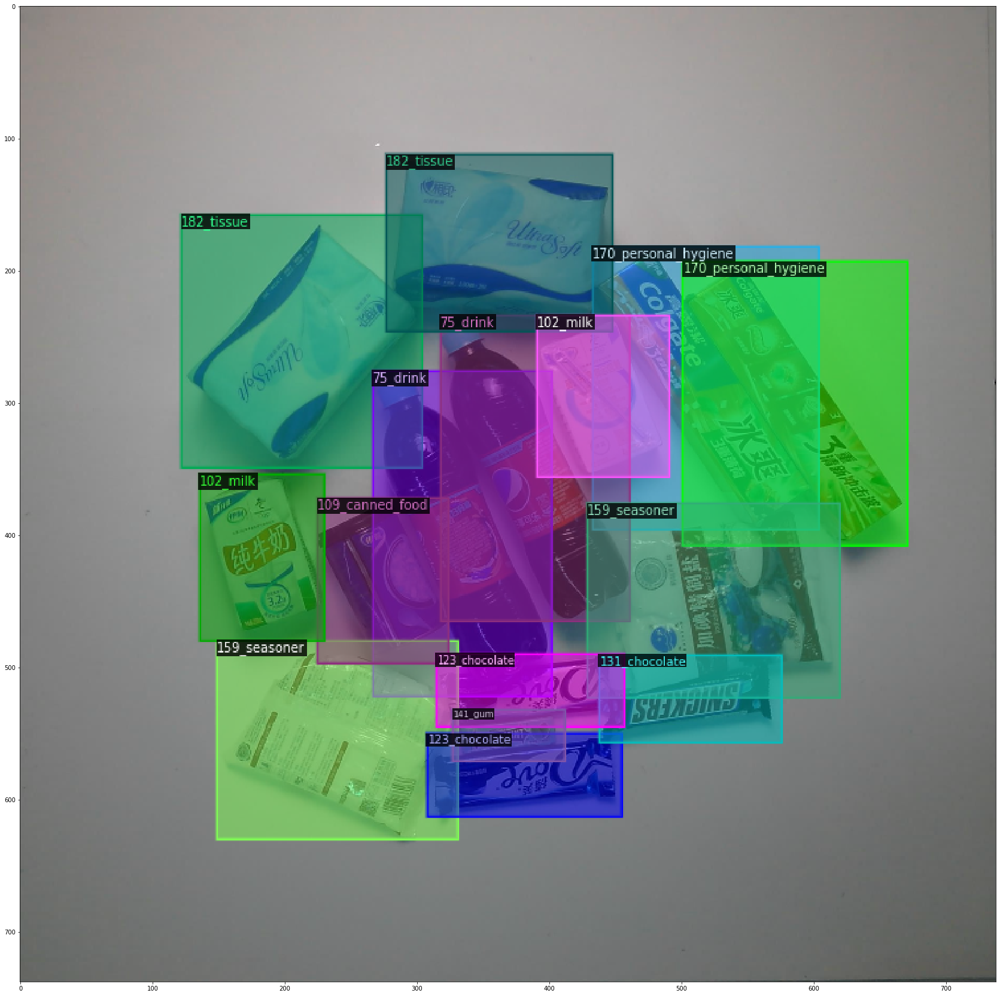

testdata2019/20181012-15-06-57-1361.jpg


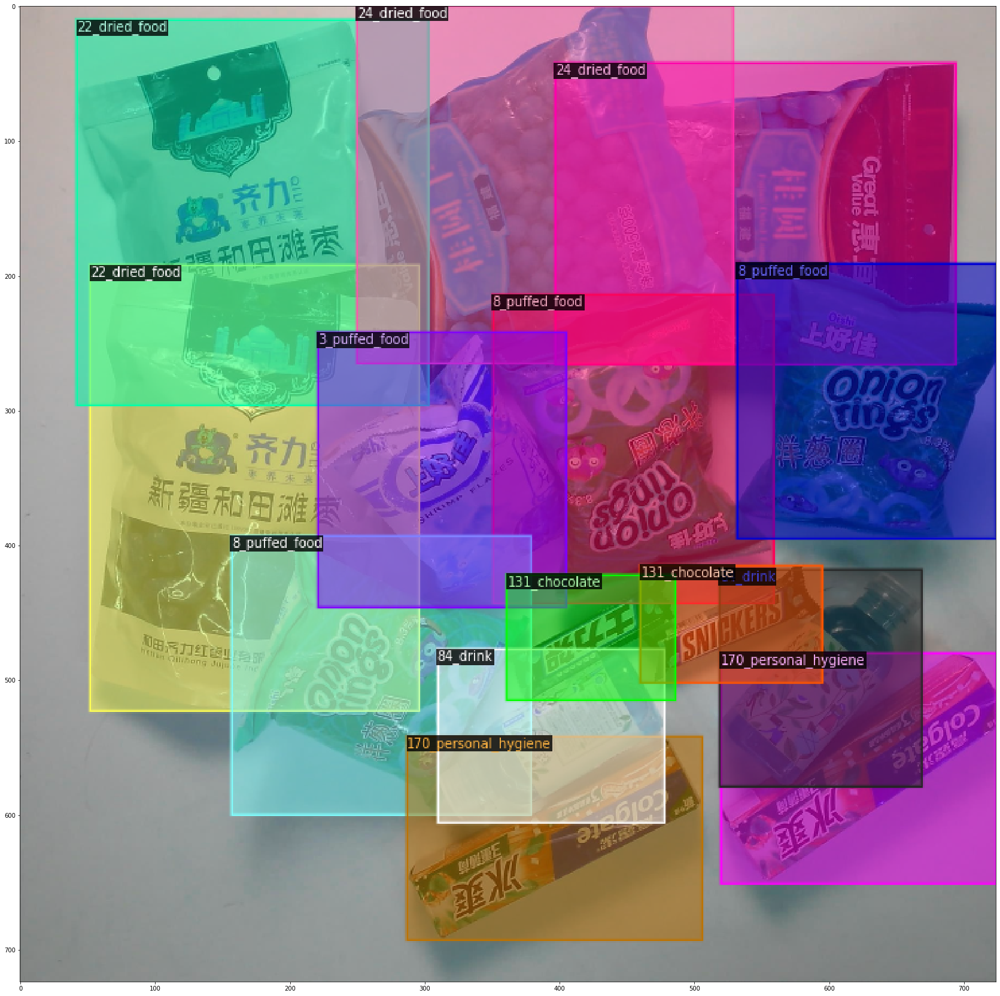

testdata2019/20181010-13-36-05-3121.jpg


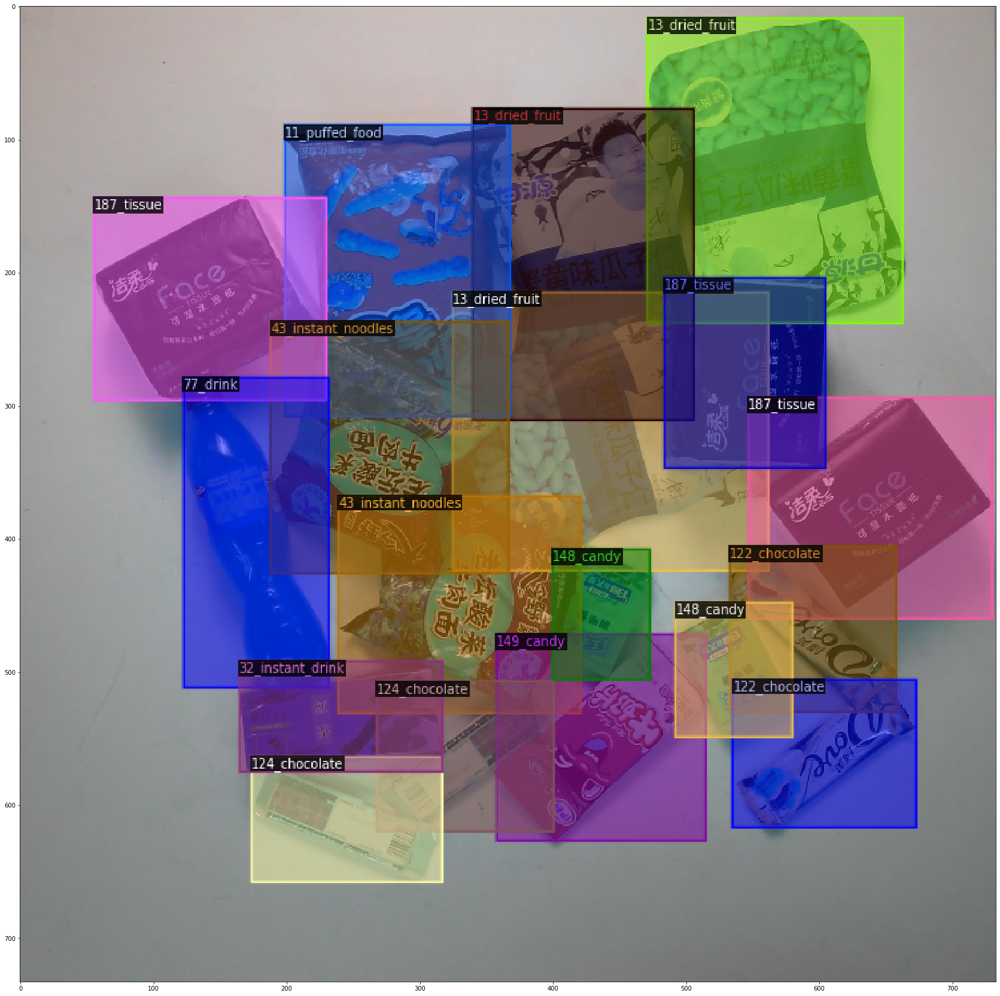

In [12]:
# VISUALISING TEST IMAGES
import matplotlib.pyplot as plt
dataset_dicts = DatasetCatalog.get("rpc_test")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    print(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=rpc_test_metadata, scale=0.4)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize=(30,30))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.show()

## Testing


---
We provide weights for an object detector trained on the RPC dataset for 5000 epochs. These weights are contained in `smart_billing_model/model_final.pth` in the shared folder.

In [13]:
# Create Default Predictor
from detectron2.engine import DefaultTrainer,DefaultPredictor
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 200
cfg.MODEL.DEVICE = 'cpu' 

cfg.MODEL.WEIGHTS = "model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set the testing threshold for this model
cfg.DATASETS.TEST = ("rpc_test", )
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True) # The trained model and checkpoints will be saved in the folder /content/output

py_predictor = DefaultPredictor(cfg)

In [15]:
from detectron2.modeling import build_model
model = build_model(cfg)
print(model)

GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequential(
        (0): BottleneckBlock

[08/03 13:34:17 d2.data.datasets.coco]: Loading test.json takes 1.64 seconds.
[08/03 13:34:17 d2.data.datasets.coco]: Loaded 6000 images in COCO format from test.json


testdata2019/20180831-13-47-33-2186.jpg


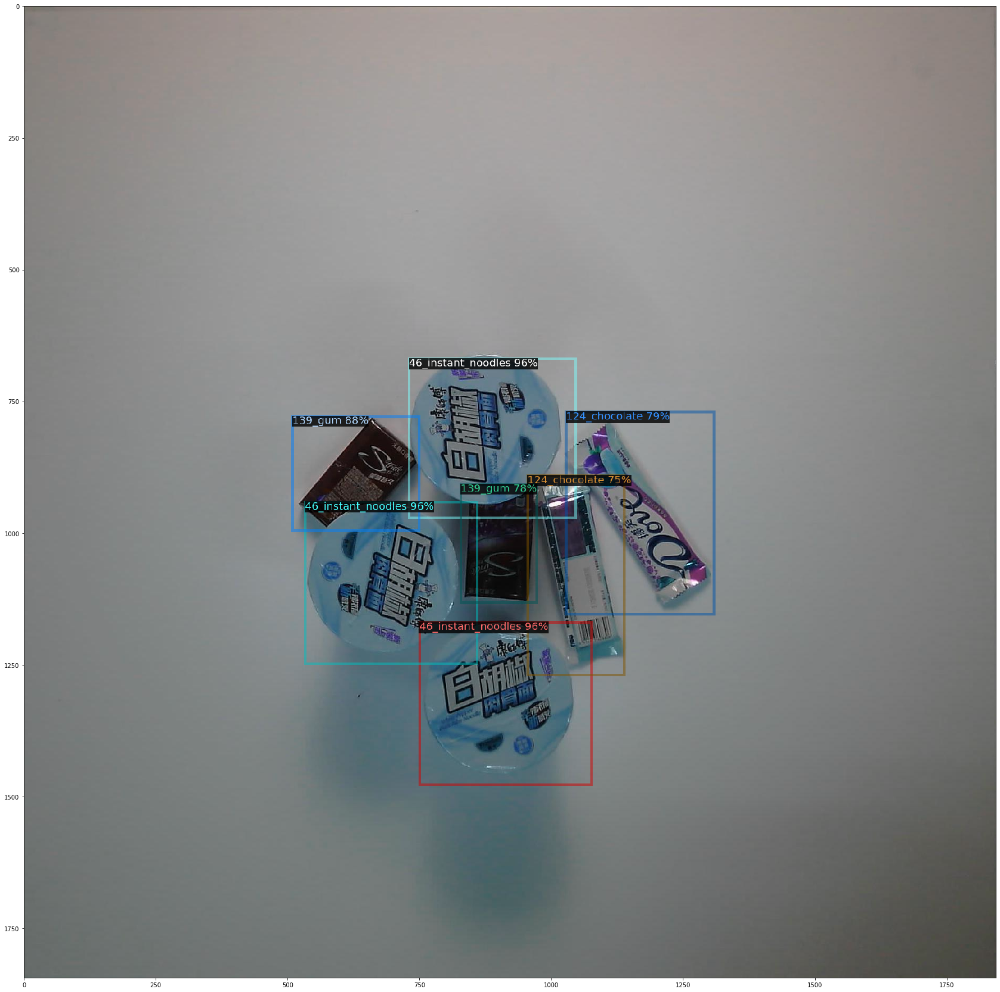

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20180829-10-50-04-1251.jpg


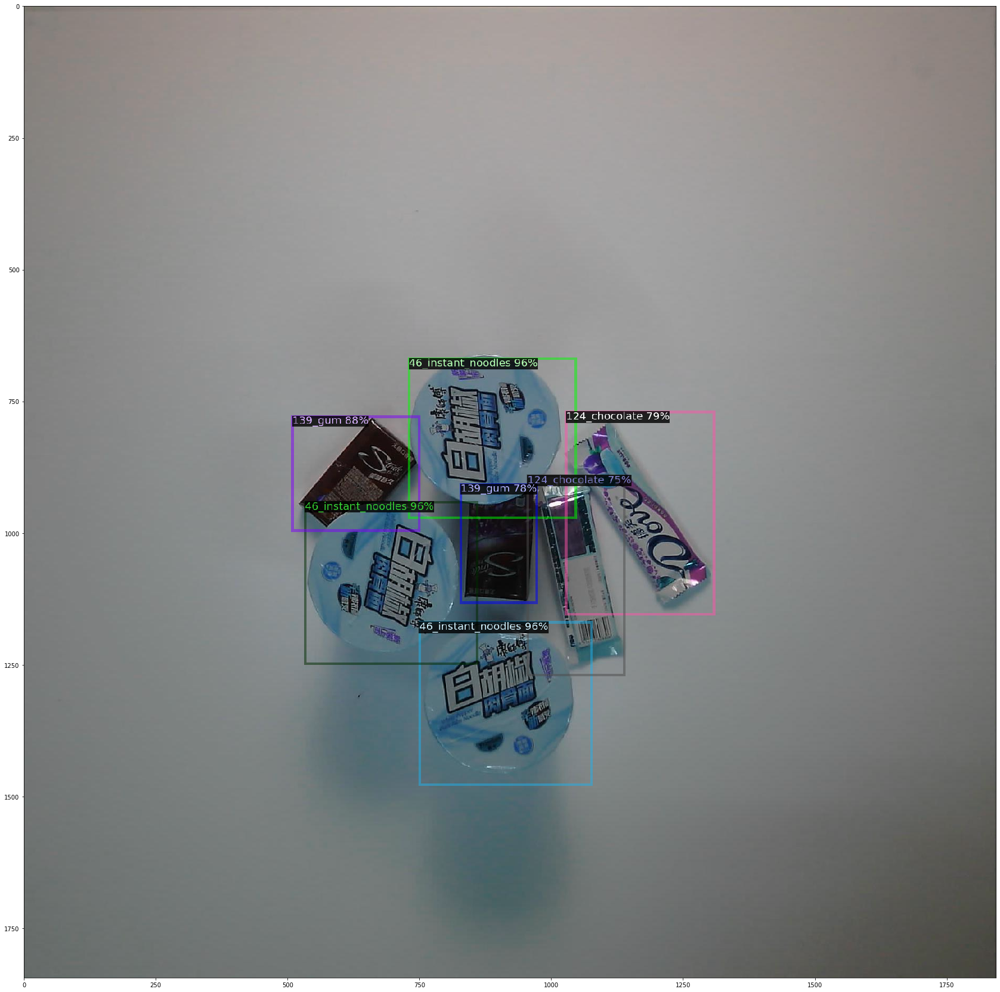

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20181025-11-13-53-76.jpg


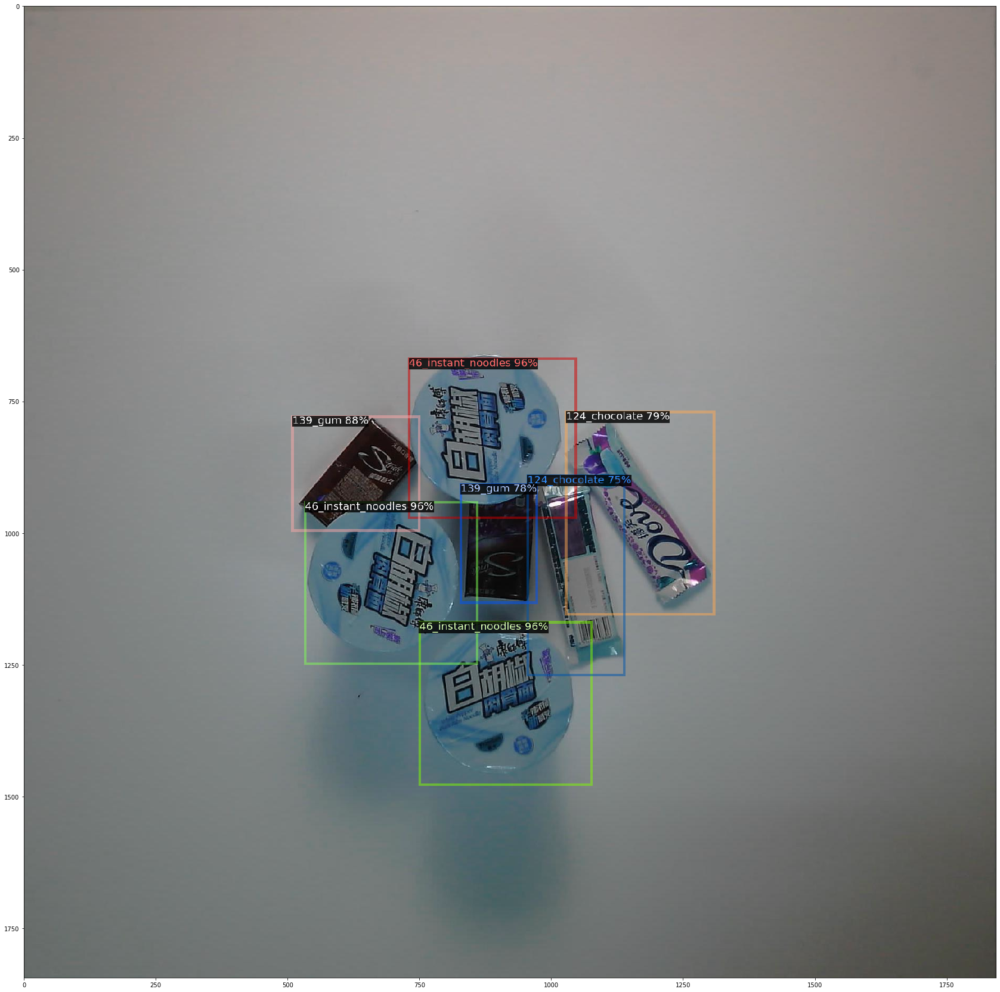

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20180919-15-02-52-1106.jpg


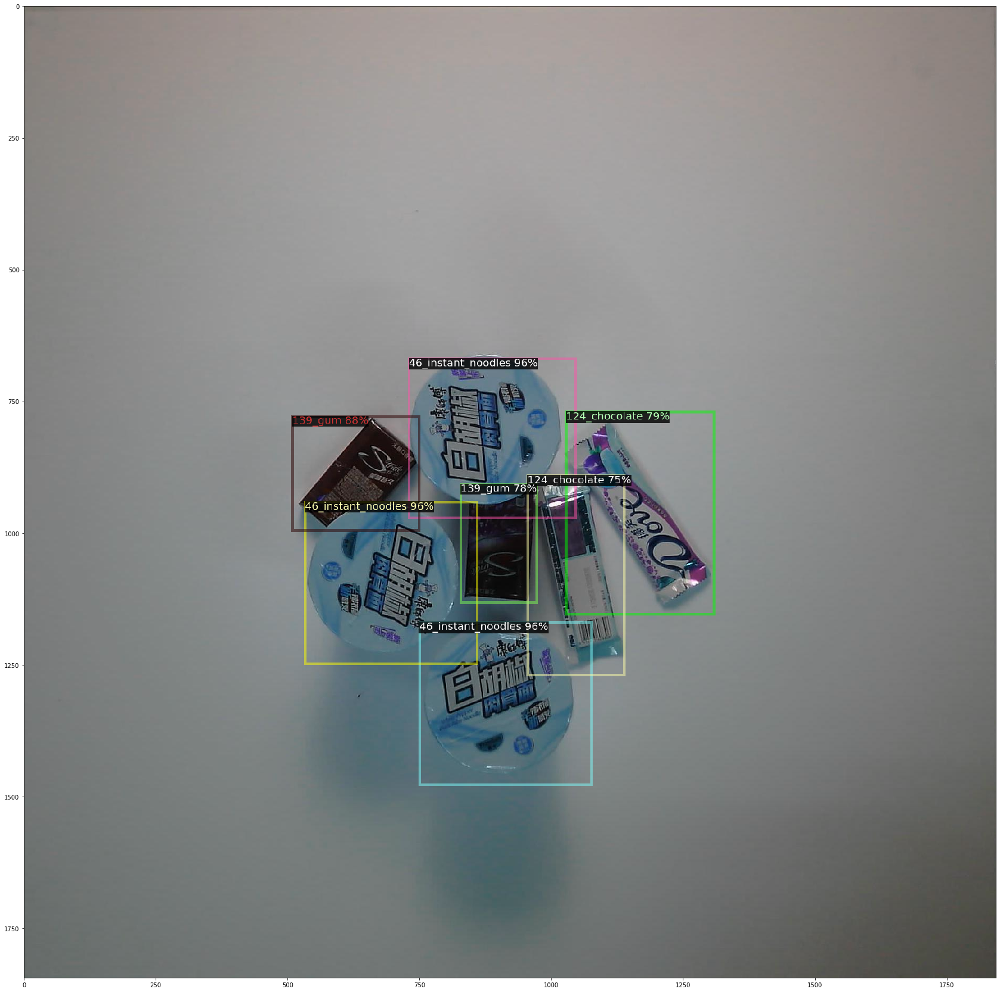

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20181025-10-06-07-171.jpg


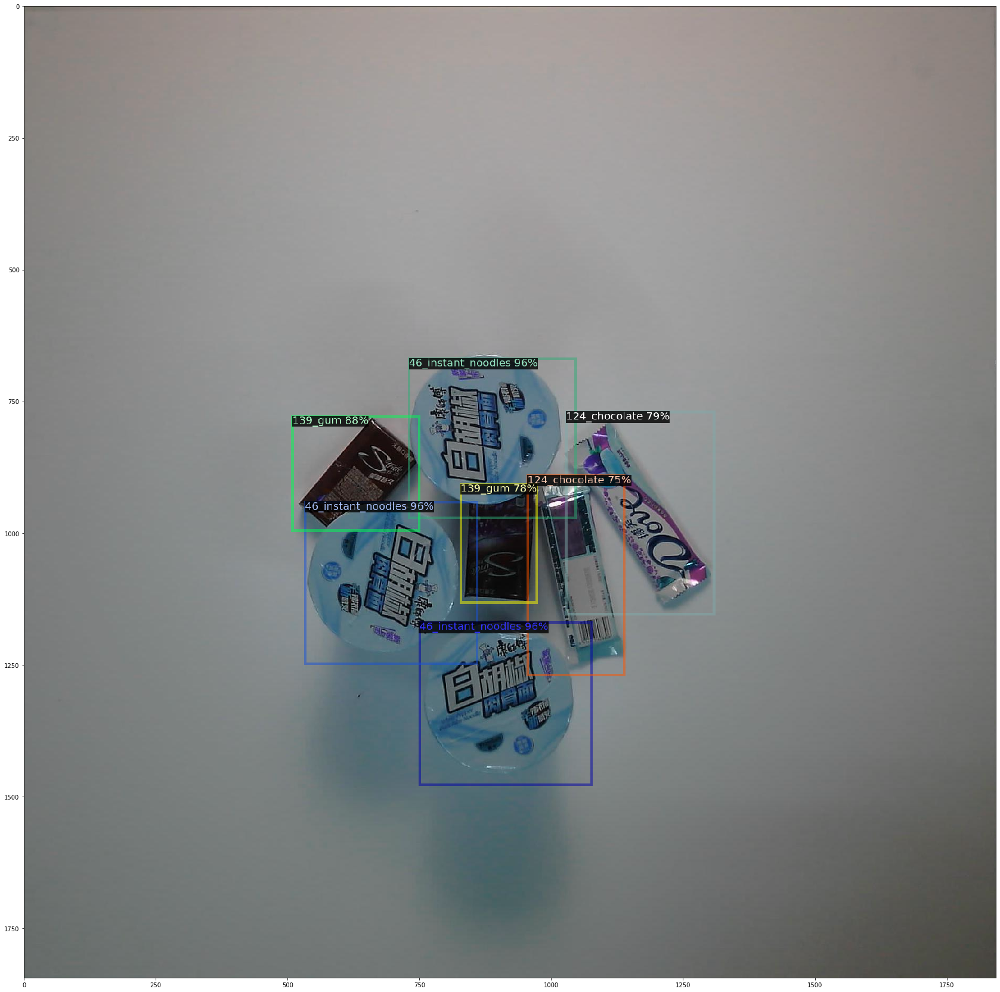

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20180829-09-38-24-1206.jpg


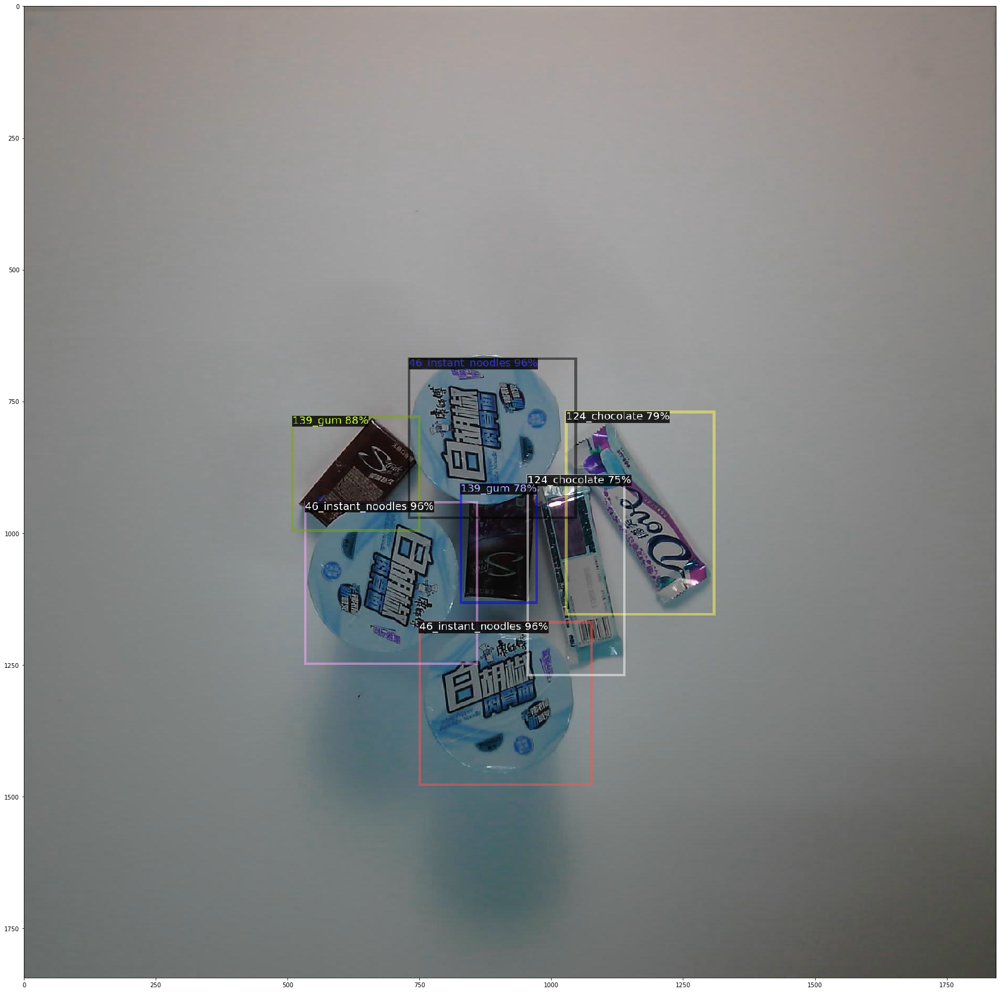

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20181019-10-49-03-2681.jpg


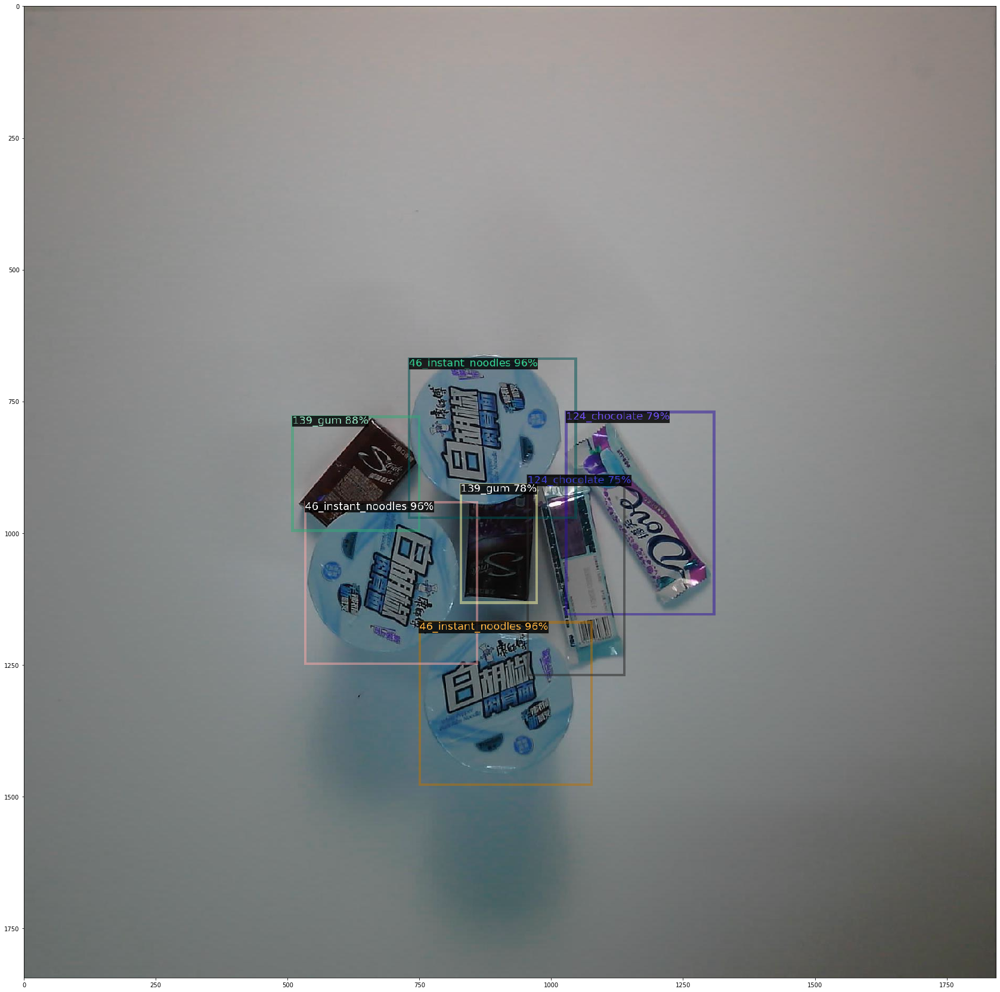

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20181023-10-55-40-3331.jpg


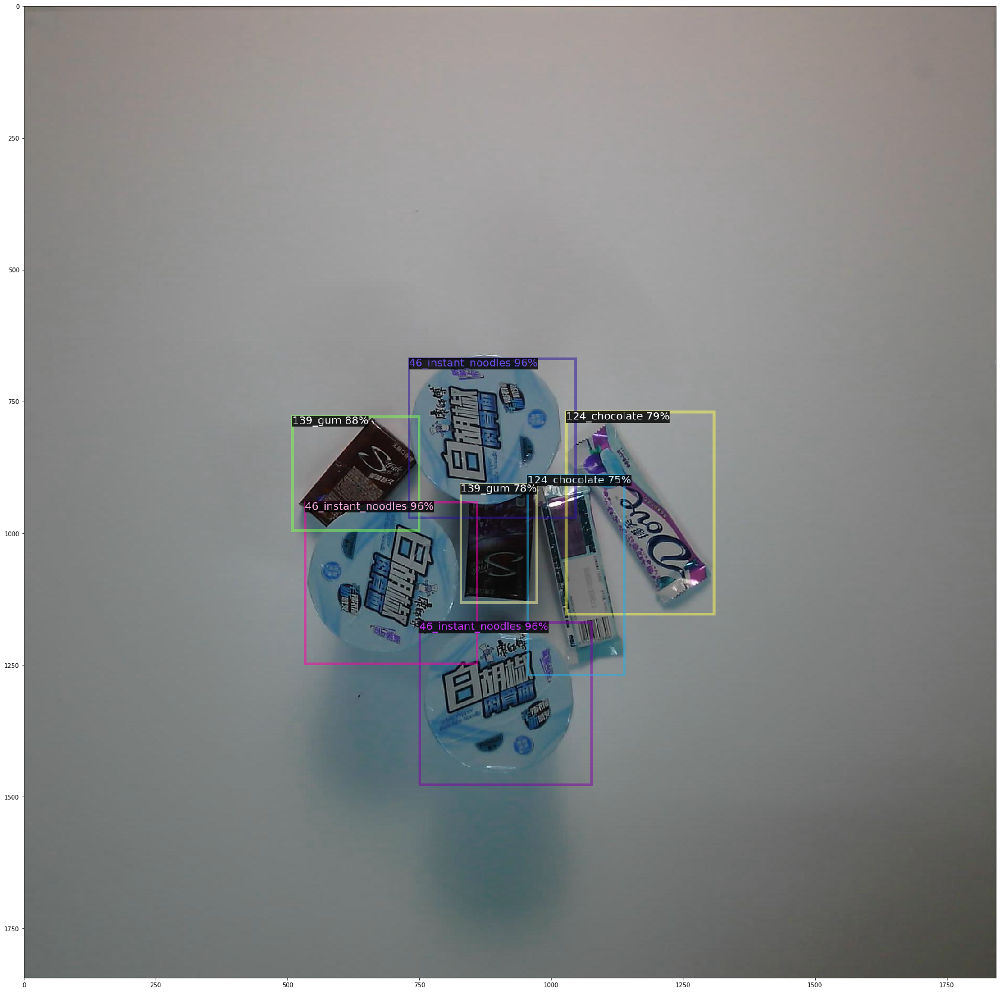

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20180919-16-38-20-1161.jpg


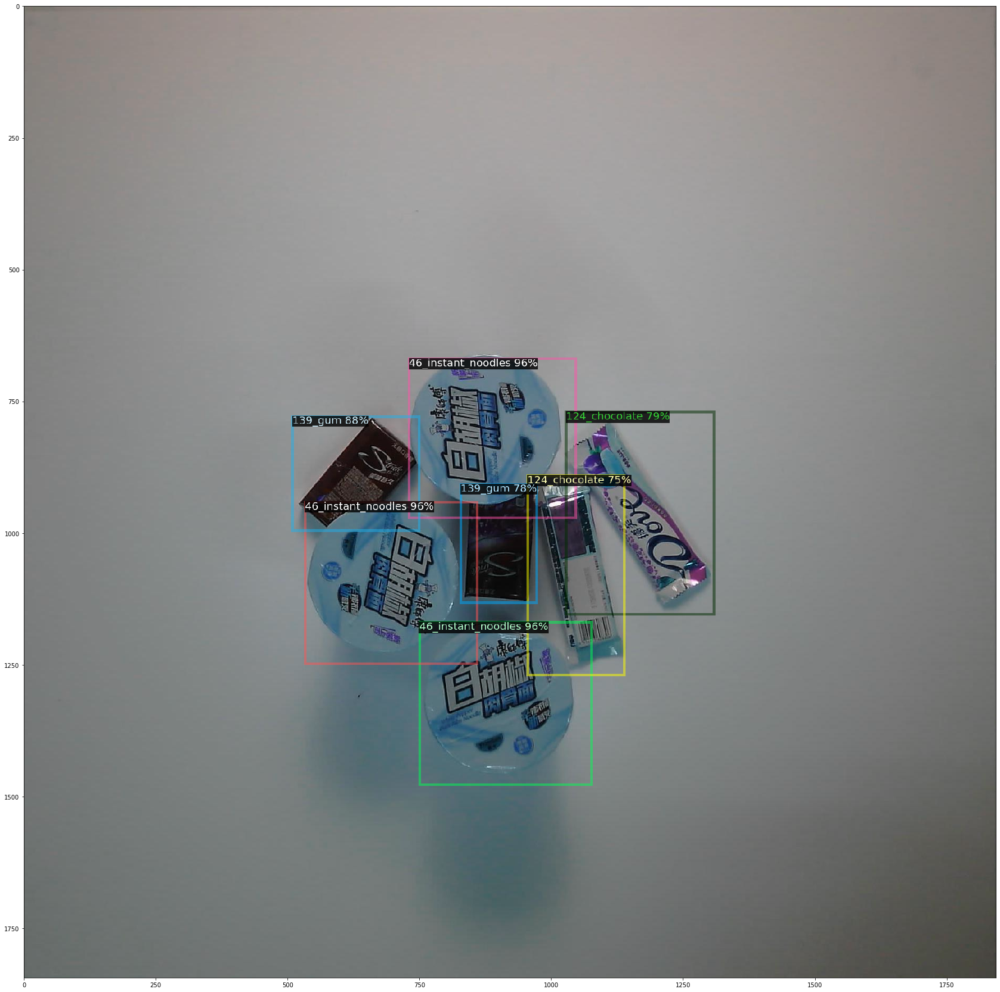

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


testdata2019/20180830-15-30-07-2006.jpg


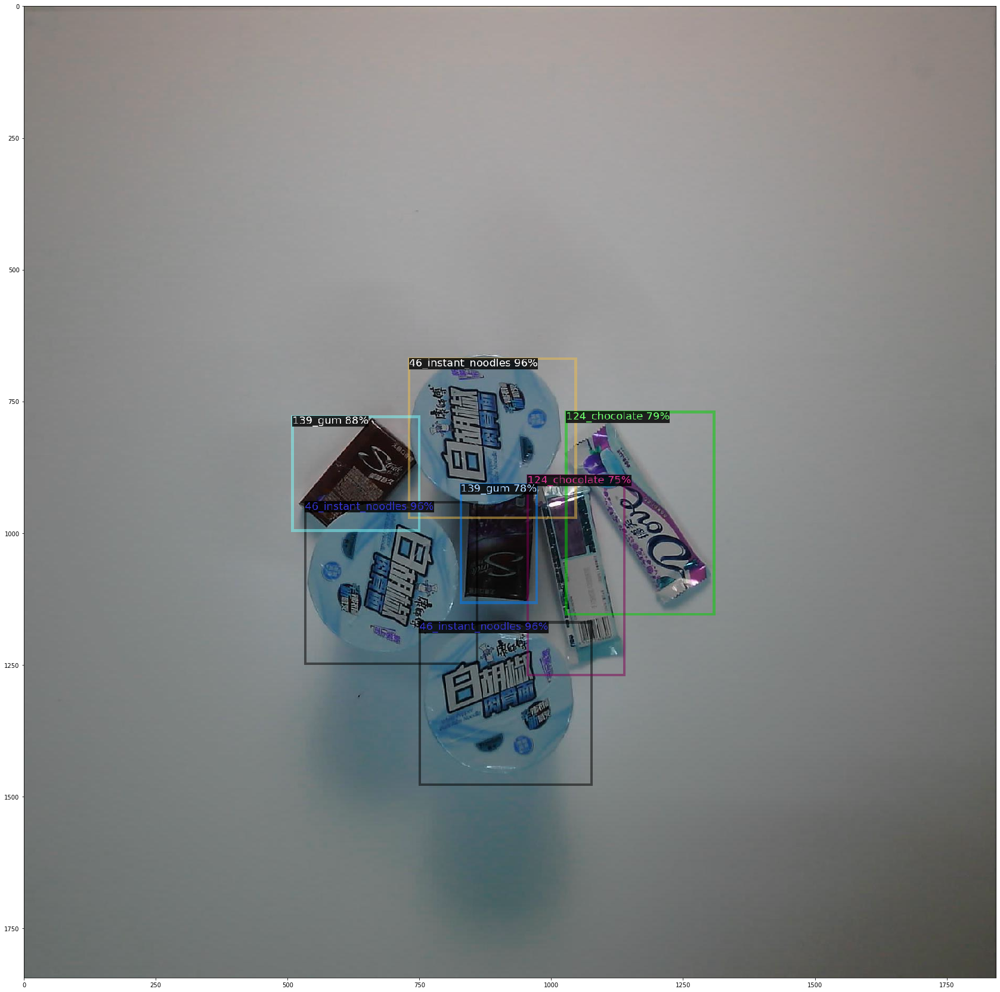

[45, 45, 45, 138, 123, 138, 123]
| Product Name       |   Quantity |
|--------------------+------------|
| 46_instant_noodles |          3 |
| 139_gum            |          2 |
| 124_chocolate      |          2 |


In [52]:
import matplotlib.pyplot as plt
from collections import defaultdict
from tabulate import tabulate

#  Visualizing detections in images randomly sampled from the test set  
dataset_dicts = DatasetCatalog.get("rpc_test")

product_names = list(rpc_test_metadata.thing_classes)
def create_list(instances):
    det_items = [product_names[i] for i in instances]
    return det_items

def print_bill(instances):
    bill = defaultdict(int)
    for i in instances:
        bill[i]+=1
    l=[]
    #print('\tProduct Name\t\tQuantity')
    for key,value in bill.items():
        l.append([product_names[int(key)],value])
    table = tabulate(l, headers=['Product Name', 'Quantity'], tablefmt='orgtbl')
    print(table)

import ast
import json

for d in random.sample(dataset_dicts, 10):  
    #im = cv2.imread(d['file_name'])
    im = cv2.imread(images[1])
    print('\n')
    print(d["file_name"])
    outputs = py_predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata = rpc_test_metadata,
                   scale=1, 
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize=(30,30))
    plt.imshow(v.get_image()[:, :, ::-1])
    image = v.get_image()[:,:,::-1]
    plt.show()
    items = outputs["instances"].pred_classes.cpu().detach().numpy()
    items = list(items)
    print(items)
    print_bill(items)

## Deploying the model and creating endpoint

--- 

Since we are using an additional custom library **detectron2** in our model, we are creating a **requirements.txt** file to install the necessary libraries and a custom **inference.py** file containing the functions to run the model.

In [5]:
## Making a list of all the test images urls 
import boto3
import json

s3 = boto3.resource('s3')
test_data_bucket = s3.Bucket(bucket_name)

images = []
pre_url = 's3://'+bucket_name+'/'

s3 = boto3.client("s3")
response = s3.list_objects_v2(Bucket=bucket_name,Prefix ='testdata2019')

for object_summary in response['Contents']:
    if '.jpg' in object_summary['Key']:
        images.append(str(object_summary['Key']))

import random
random.shuffle(images)

In [41]:
# Creating the tar file for our custom deployment
import tarfile
import boto3

s3_client = boto3.client('s3')
file_name = "retail_checkout_model.tar.gz"

tar = tarfile.open(file_name, "w:gz")
tar.add('model_final.pth')
tar.add('code')
tar.close()

bucket_name = 'retail-checkout-data'
s3_client.upload_file('retail_checkout_model.tar.gz',
                       bucket_name,
                      'retail_checkout_model.tar.gz')

In [42]:
# Deploying trained pytorch model(detectron2 is built on pytorch)

from sagemaker.pytorch import PyTorchModel
from sagemaker import get_execution_role
import time

role = get_execution_role()# You can also configure a sagemaker role and reference it by its name.
print(role)
start = time.time()
pytorch_model = PyTorchModel(model_data='s3://retail-checkout-data/retail_checkout_model.tar.gz',
                             role=role, entry_point='code/inference.py', framework_version='1.4')
predictor = pytorch_model.deploy(instance_type='ml.t2.large',
                                 initial_instance_count=1)

end = time.time()

print('\n')
print(end-start)

Parameter image will be renamed to image_uri in SageMaker Python SDK v2.
'create_image_uri' will be deprecated in favor of 'ImageURIProvider' class in SageMaker Python SDK v2.


arn:aws:iam::961707574698:role/service-role/AmazonSageMaker-ExecutionRole-20200628T154739
-------------------!

621.3542203903198


20180827-16-27-27-776.jpg


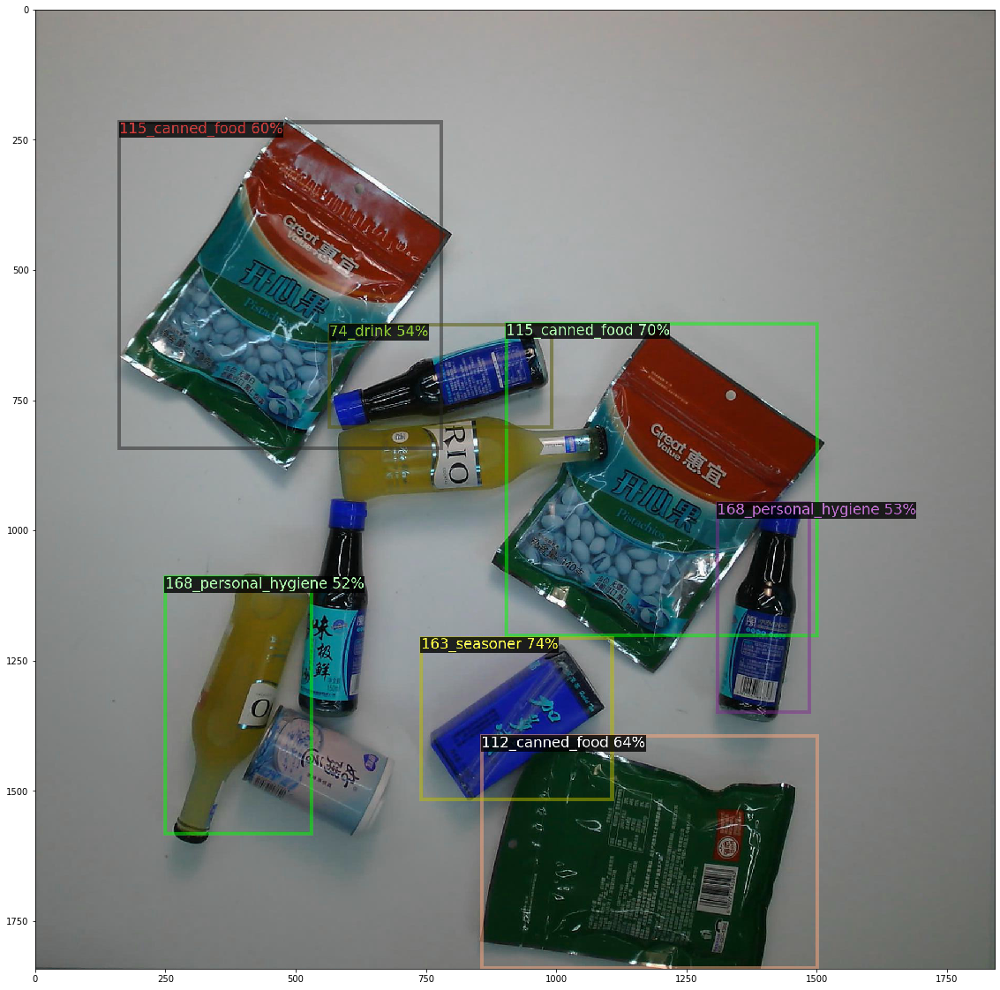

| Product Name         |   Quantity |
|----------------------+------------|
| 70_dessert           |          1 |
| 17_dried_fruit       |          2 |
| 14_dried_fruit       |          1 |
| 172_personal_hygiene |          1 |
| 75_drink             |          2 |
inference of image 20180827-16-27-27-776.jpg done in 7.3324 seconds
20180827-10-19-40-131.jpg


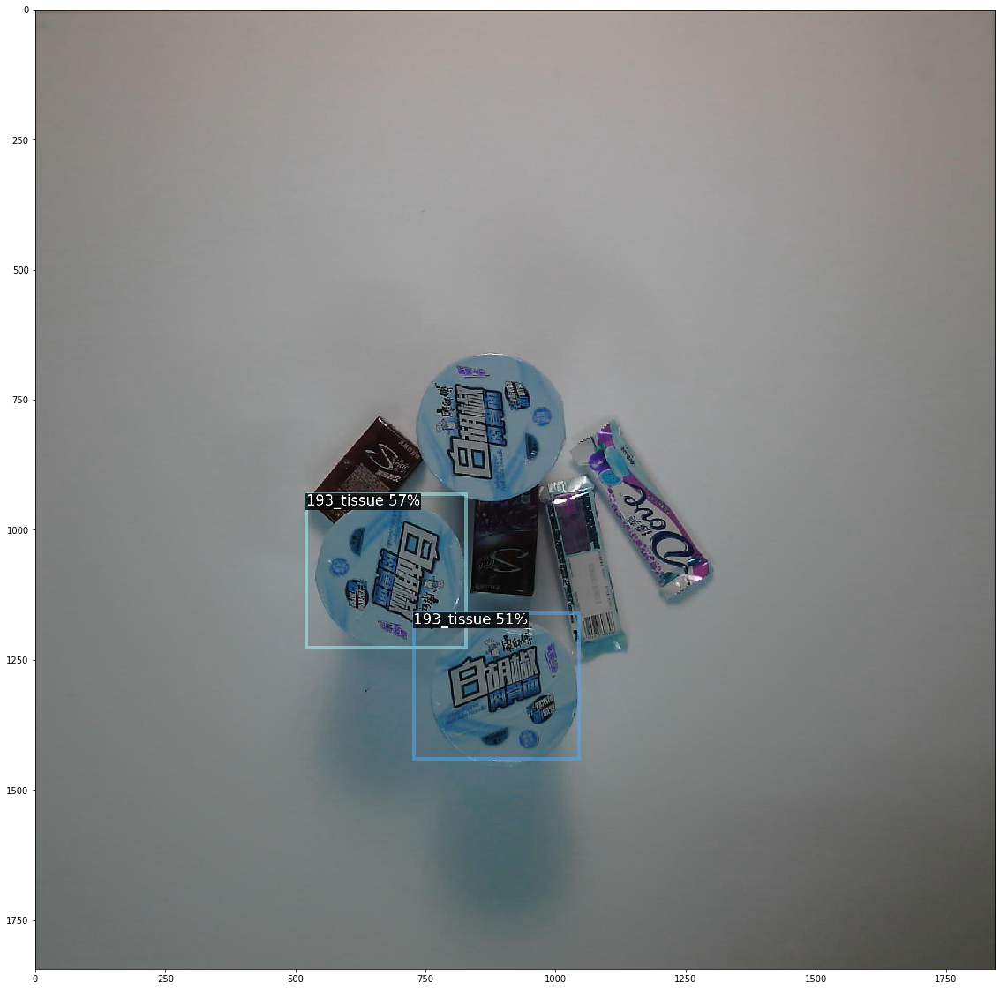

| Product Name   |   Quantity |
|----------------+------------|
| 103_milk       |          2 |
inference of image 20180827-10-19-40-131.jpg done in 7.4424 seconds
20180827-14-36-00-231.jpg


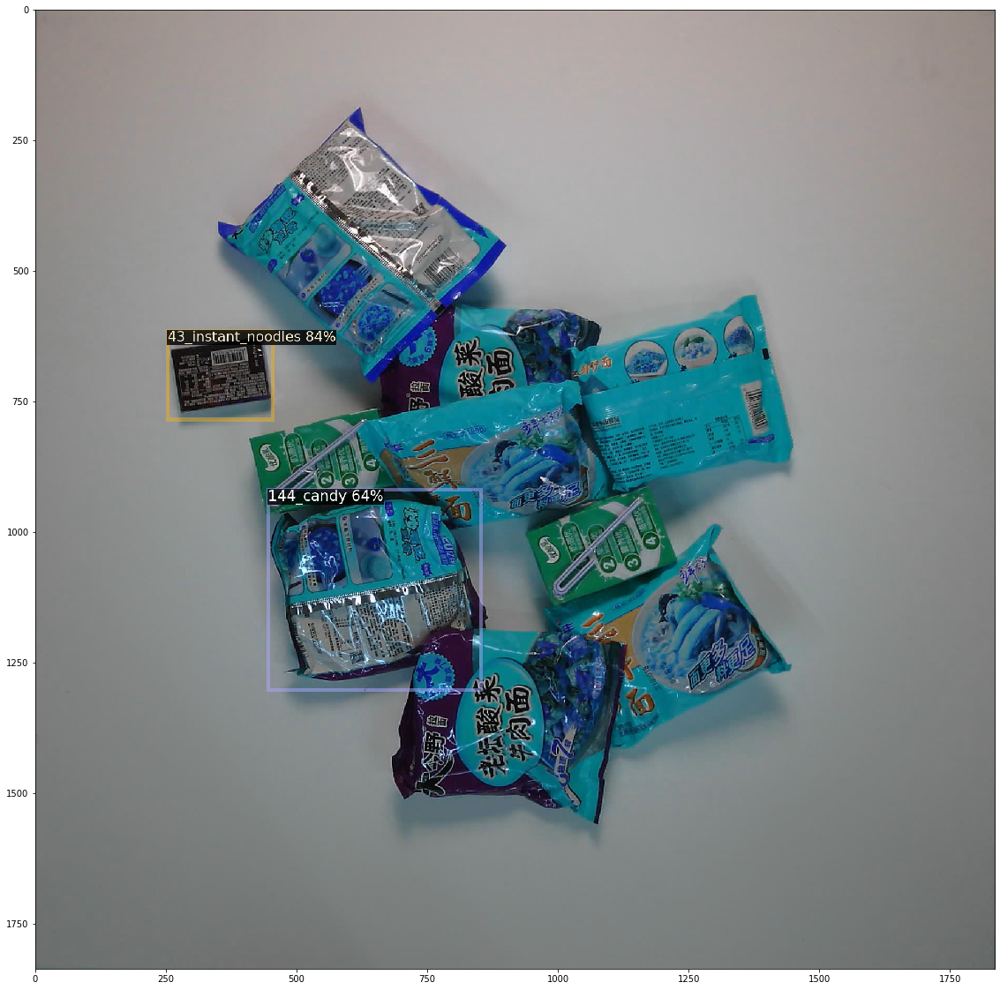

| Product Name       |   Quantity |
|--------------------+------------|
| 138_gum            |          1 |
| 49_instant_noodles |          1 |
inference of image 20180827-14-36-00-231.jpg done in 7.46 seconds
20180828-14-09-42-896.jpg


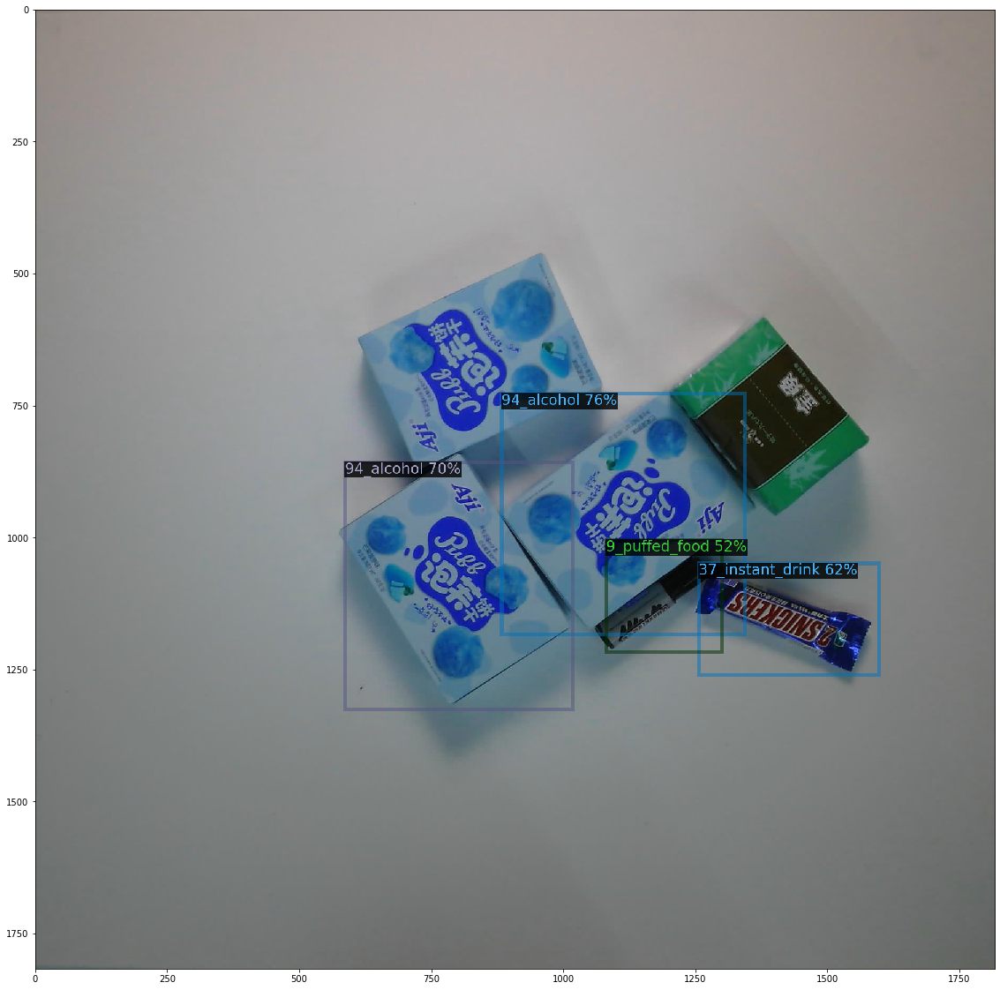

| Product Name   |   Quantity |
|----------------+------------|
| 194_stationery |          2 |
| 131_chocolate  |          1 |
| 200_stationery |          1 |
inference of image 20180828-14-09-42-896.jpg done in 7.3751 seconds
20180827-15-40-48-731.jpg


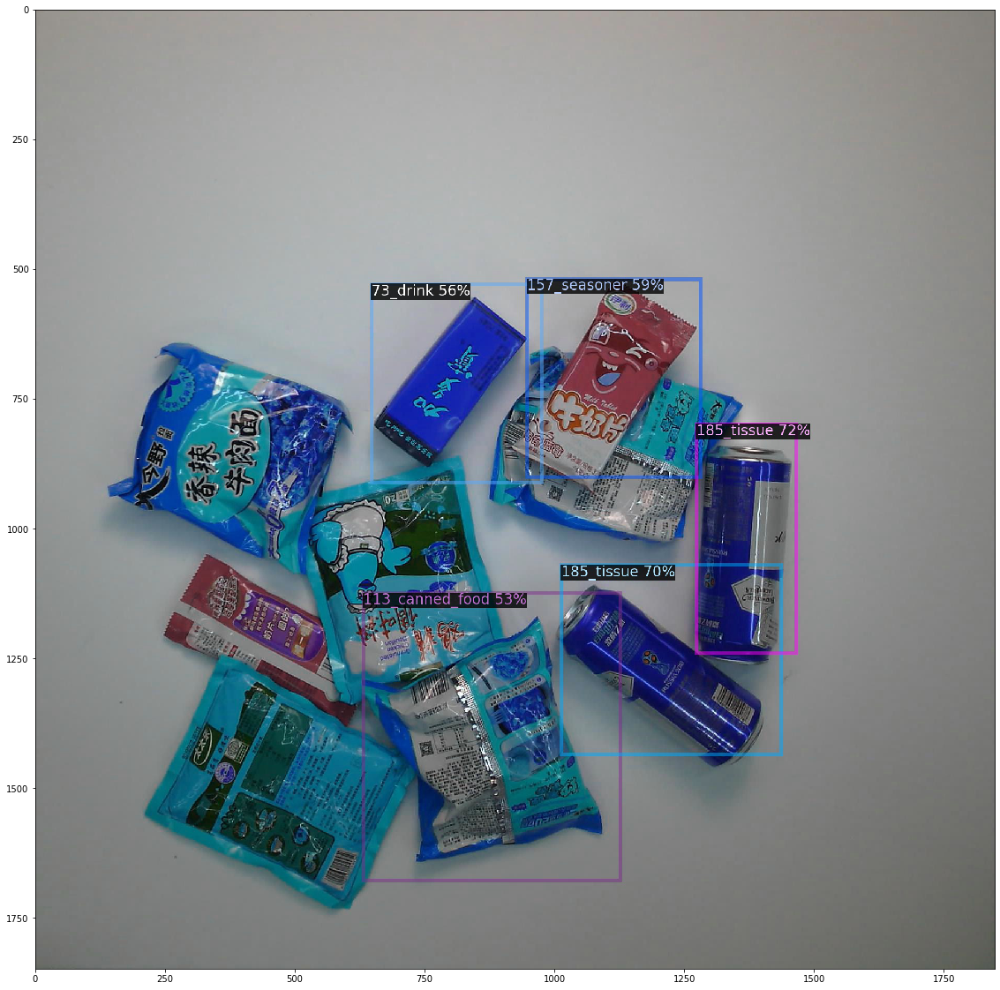

| Product Name         |   Quantity |
|----------------------+------------|
| 94_alcohol           |          2 |
| 63_dessert           |          1 |
| 171_personal_hygiene |          1 |
| 15_dried_fruit       |          1 |
inference of image 20180827-15-40-48-731.jpg done in 7.3939 seconds
20180829-14-22-16-1351.jpg


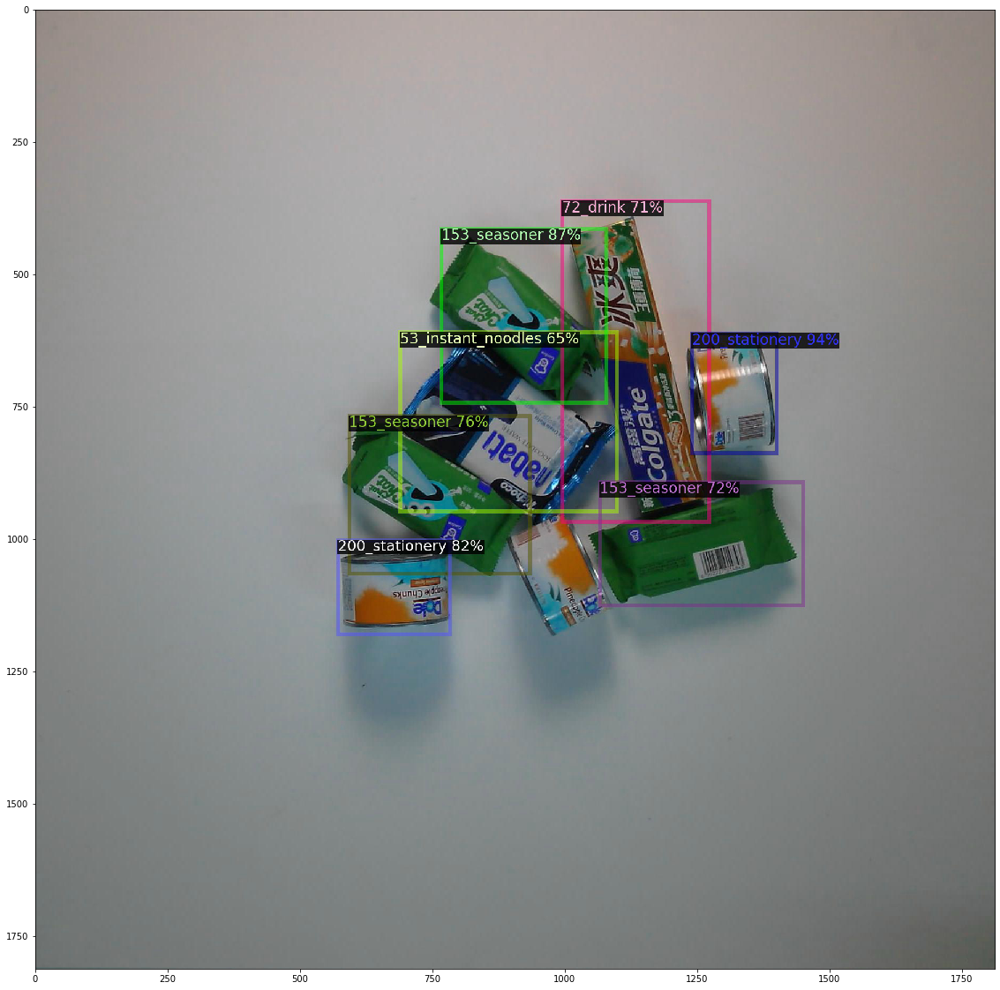

| Product Name         |   Quantity |
|----------------------+------------|
| 112_canned_food      |          2 |
| 59_dessert           |          3 |
| 170_personal_hygiene |          1 |
| 149_candy            |          1 |
inference of image 20180829-14-22-16-1351.jpg done in 7.4188 seconds
20180828-13-07-00-1106.jpg


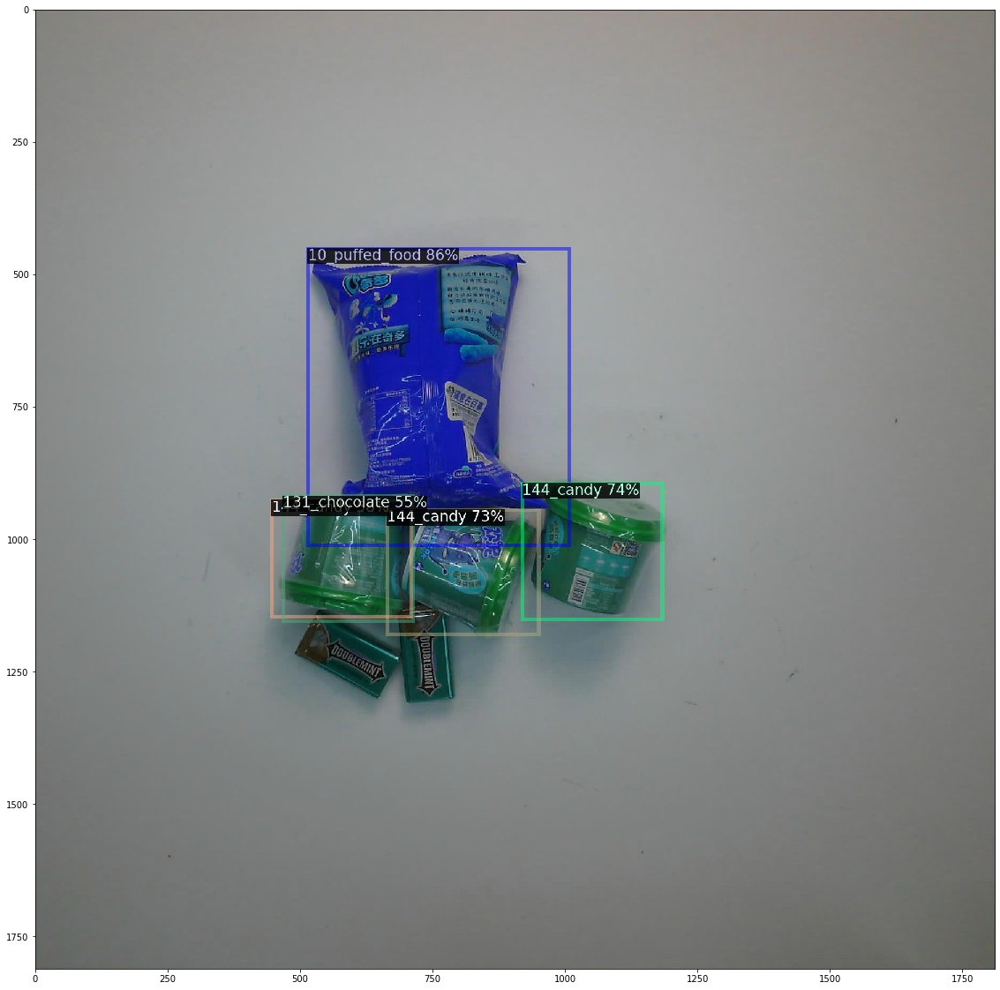

| Product Name       |   Quantity |
|--------------------+------------|
| 11_puffed_food     |          1 |
| 49_instant_noodles |          3 |
| 35_instant_drink   |          1 |
inference of image 20180828-13-07-00-1106.jpg done in 7.4504 seconds
20180827-15-45-42-736.jpg


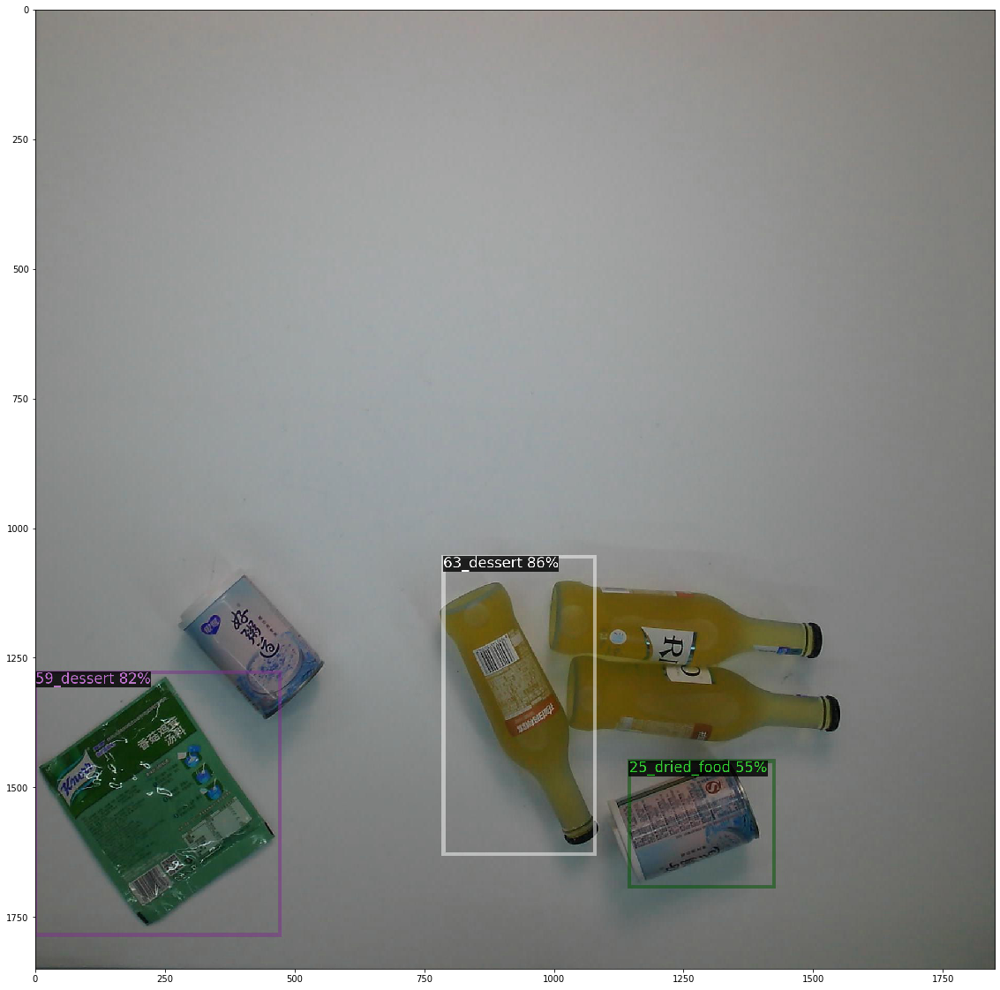

| Product Name    |   Quantity |
|-----------------+------------|
| 160_seasoner    |          1 |
| 155_seasoner    |          1 |
| 118_canned_food |          1 |
inference of image 20180827-15-45-42-736.jpg done in 7.47 seconds
20180828-14-14-16-1156.jpg


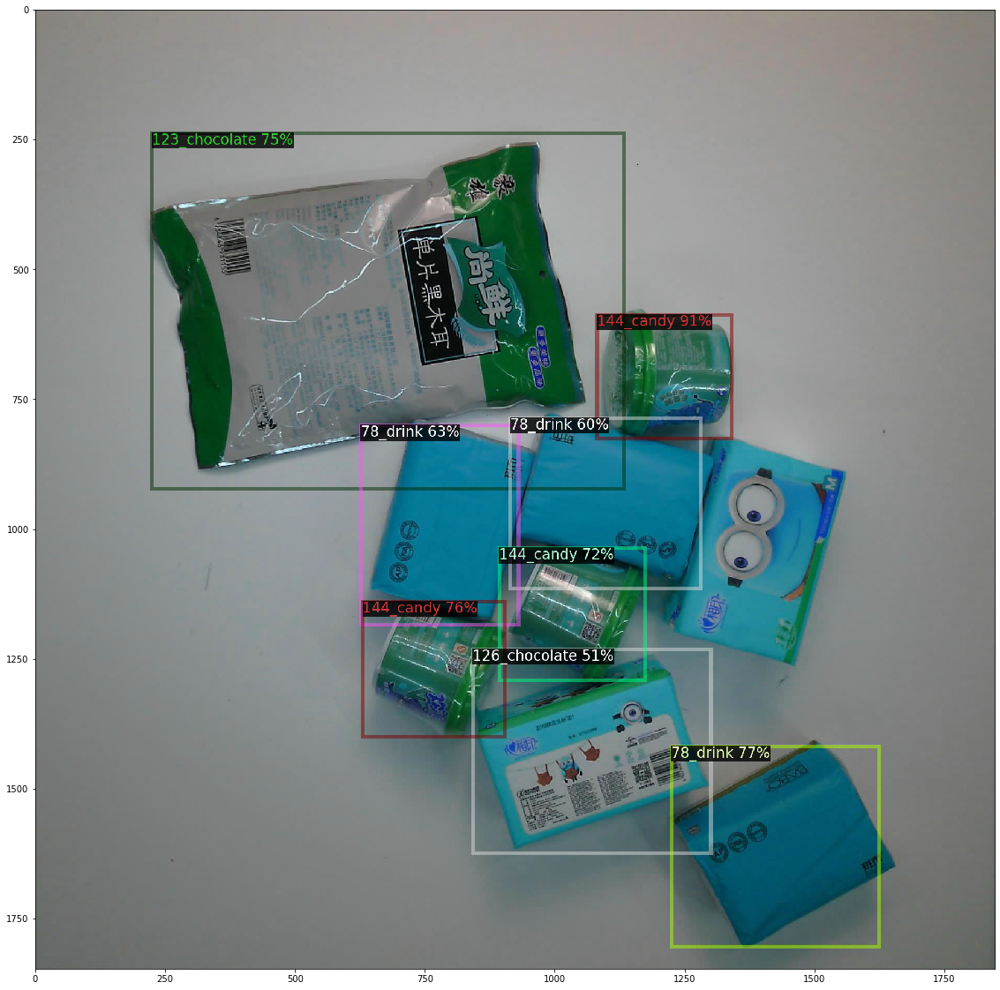

| Product Name       |   Quantity |
|--------------------+------------|
| 49_instant_noodles |          3 |
| 176_tissue         |          3 |
| 26_dried_food      |          1 |
| 29_dried_food      |          1 |
inference of image 20180828-14-14-16-1156.jpg done in 7.7086 seconds
20180828-09-31-42-371.jpg


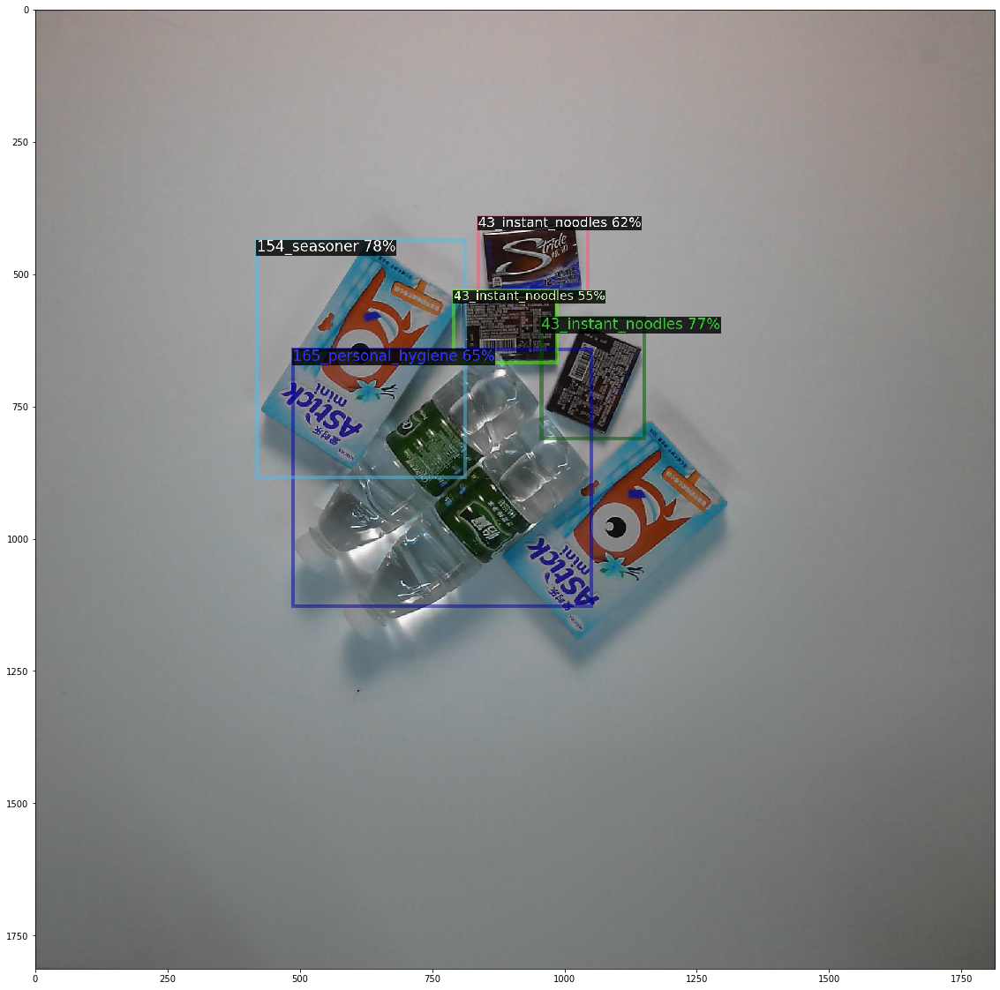

| Product Name   |   Quantity |
|----------------+------------|
| 60_dessert     |          1 |
| 138_gum        |          3 |
| 72_drink       |          1 |
inference of image 20180828-09-31-42-371.jpg done in 7.5734 seconds


In [56]:
# Getting inference from the deployed model.
import time
from sagemaker.predictor import json_serializer
from PIL import Image
content_type = "application/json"                           # The MIME type of the input data in the request body.
accept = "application/json"                                              # The desired MIME type of the inference in the response.

predictor.content_type = content_type
predictor.accept = accept
predictor.serializer = json_serializer

product_list = ",".join(product_names)

s3 = boto3.resource('s3')
bucket = s3.Bucket('retail-checkout-data')

number_of_imgs = 10

random.shuffle(images)

for img in images[:number_of_imgs]:
    payload = {"url":img,
               "products_list":str(product_list)}
    start = time.time()
    answer = predictor.predict(payload)
    end = time.time()
    answer = np.array_str(answer)
    answer = answer.replace("'",'"')
    json_data = json.loads(answer)
    image_name = img.strip().split('/')[-1]
    print(image_name)
    img_object = bucket.Object('results/'+image_name)
    file_stream = img_object.get()['Body']
    image_data = np.array(Image.open(file_stream))
    plt.figure(figsize=(20,20))
    plt.imshow(image_data)
    plt.show()
    print_bill(json_data['result'])
    print("inference of image", image_name,"done in", round(end-start,4),"seconds")

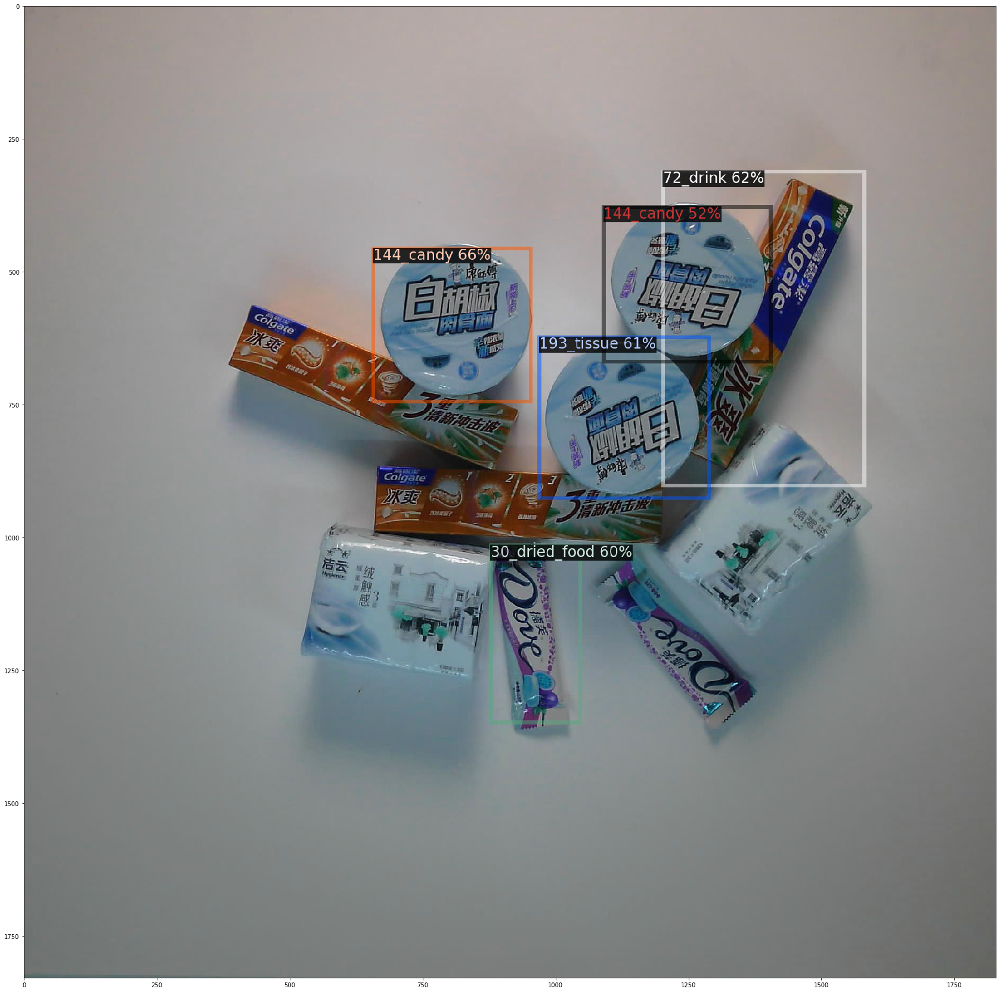

| Product Name         |   Quantity |
|----------------------+------------|
| 49_instant_noodles   |          2 |
| 170_personal_hygiene |          1 |
| 103_milk             |          1 |
| 124_chocolate        |          1 |


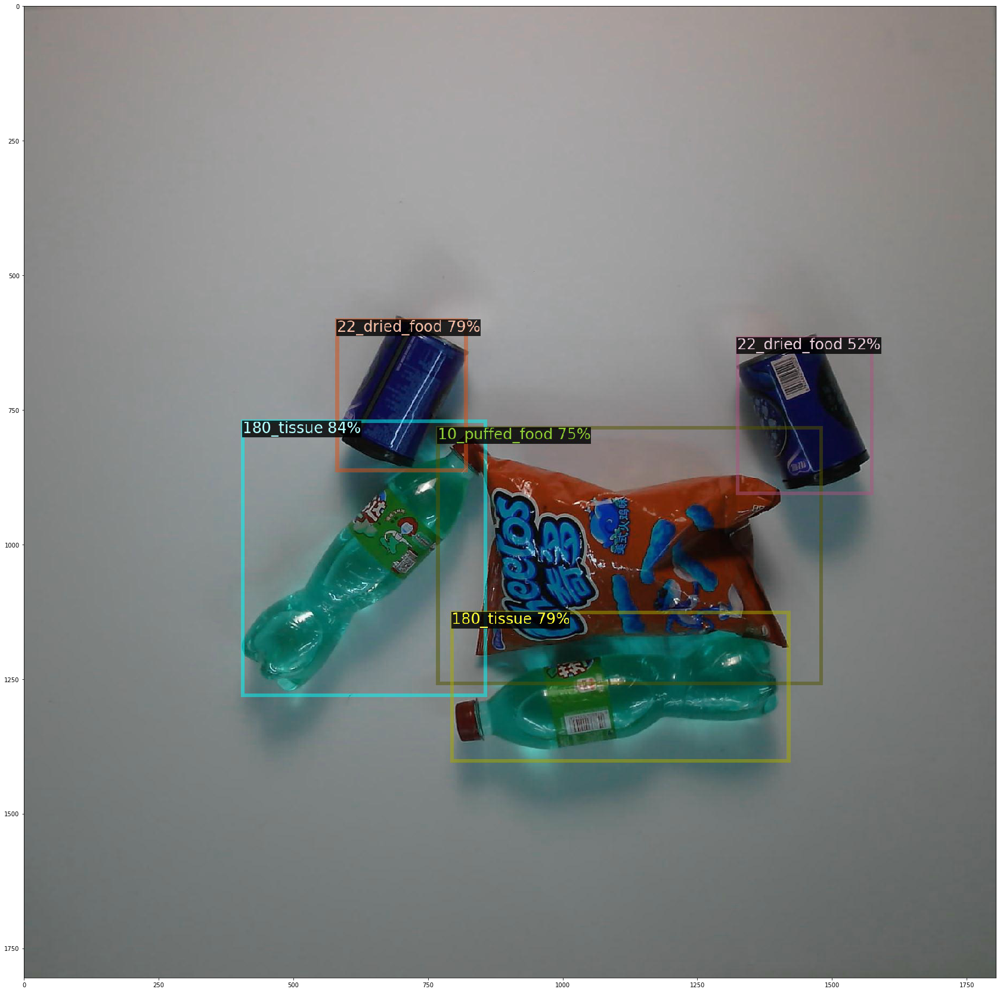

| Product Name    |   Quantity |
|-----------------+------------|
| 89_alcohol      |          2 |
| 115_canned_food |          2 |
| 11_puffed_food  |          1 |


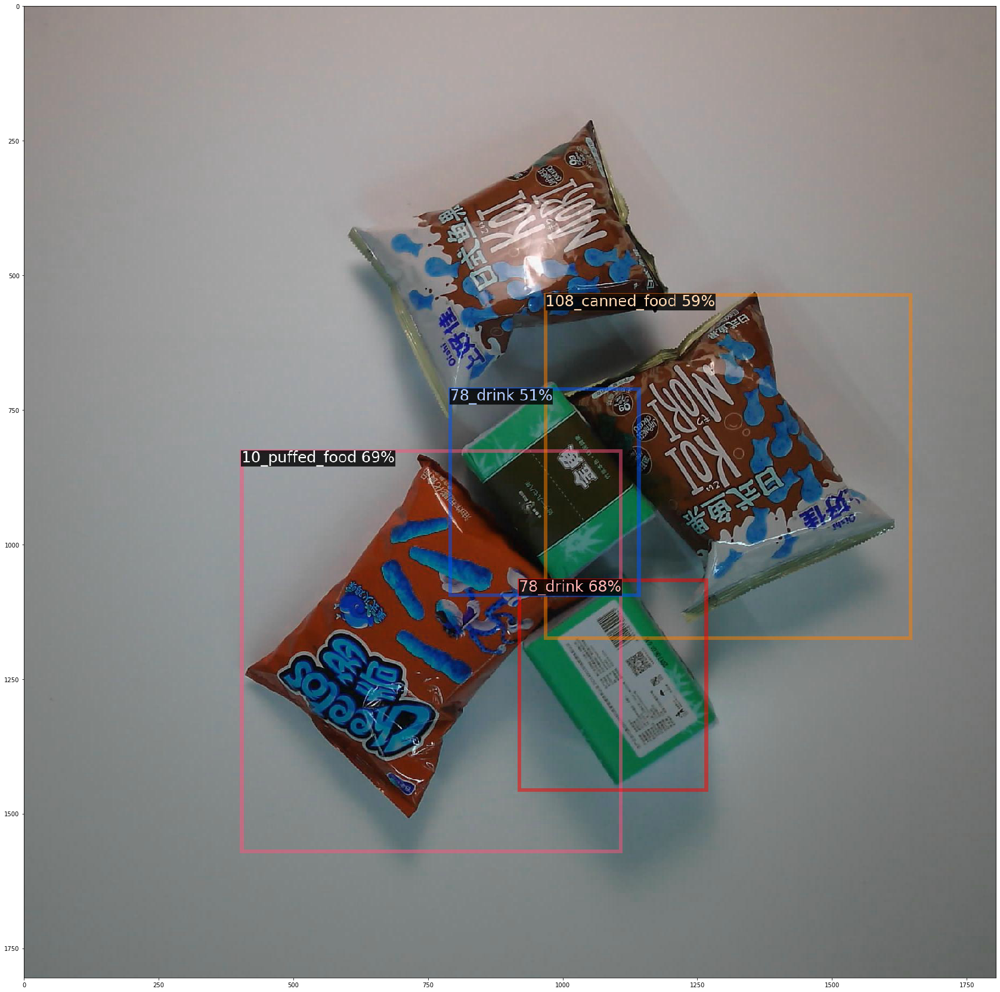

| Product Name   |   Quantity |
|----------------+------------|
| 11_puffed_food |          1 |
| 176_tissue     |          2 |
| 9_puffed_food  |          1 |


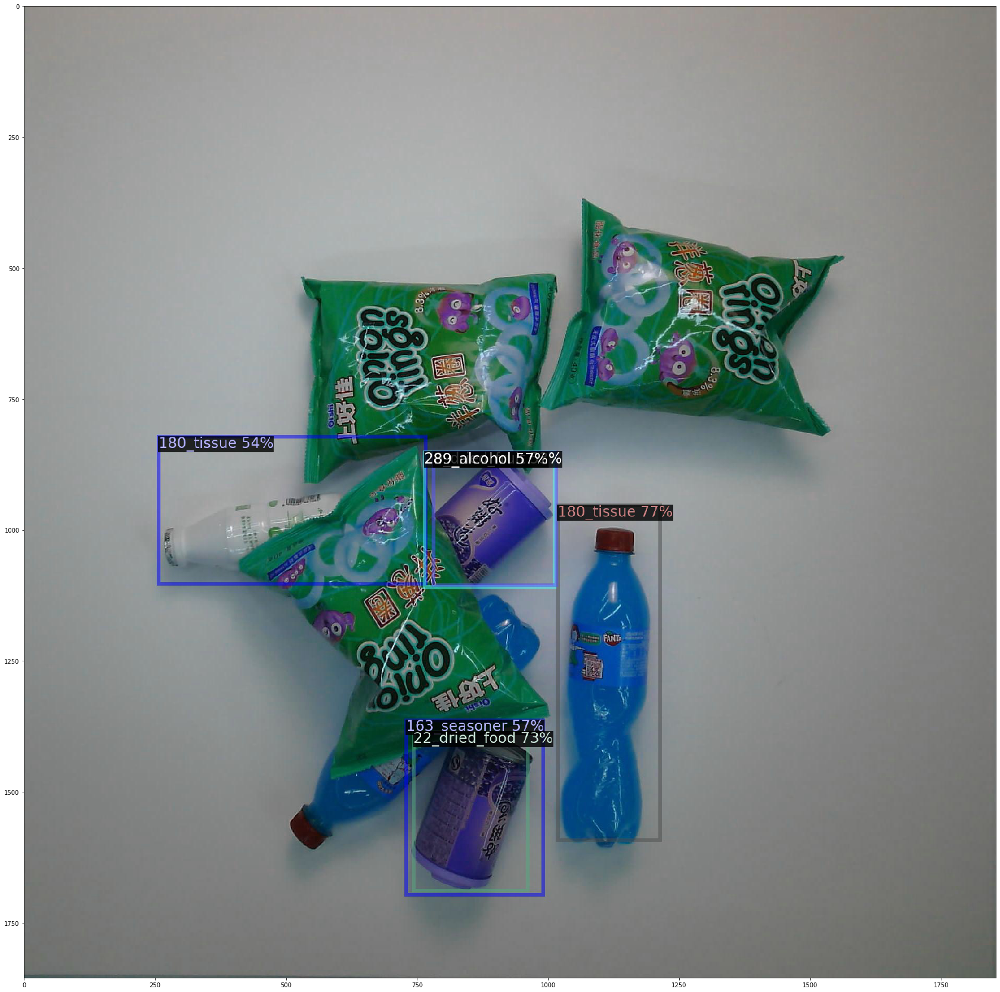

| Product Name    |   Quantity |
|-----------------+------------|
| 89_alcohol      |          2 |
| 115_canned_food |          1 |
| 188_tissue      |          1 |
| 70_dessert      |          1 |
| 113_canned_food |          1 |


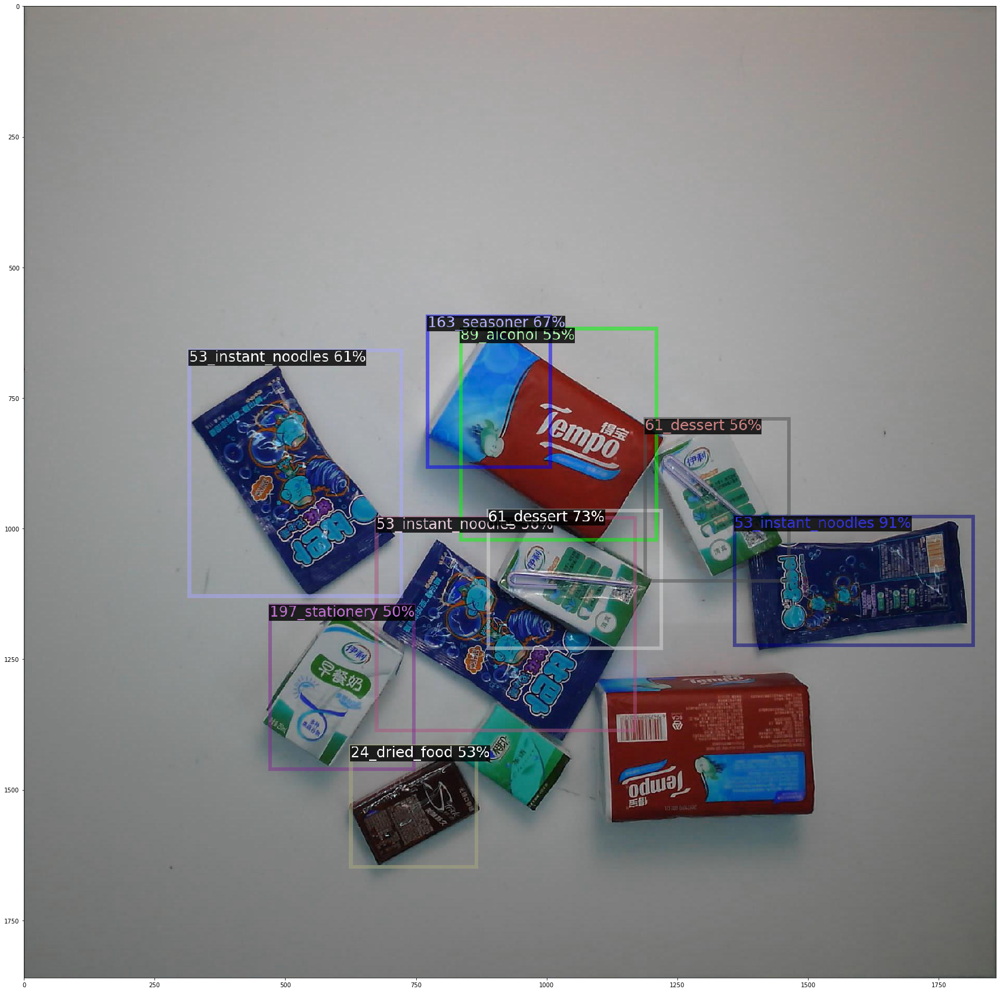

| Product Name    |   Quantity |
|-----------------+------------|
| 149_candy       |          3 |
| 158_seasoner    |          2 |
| 70_dessert      |          1 |
| 188_tissue      |          1 |
| 117_canned_food |          1 |
| 107_milk        |          1 |


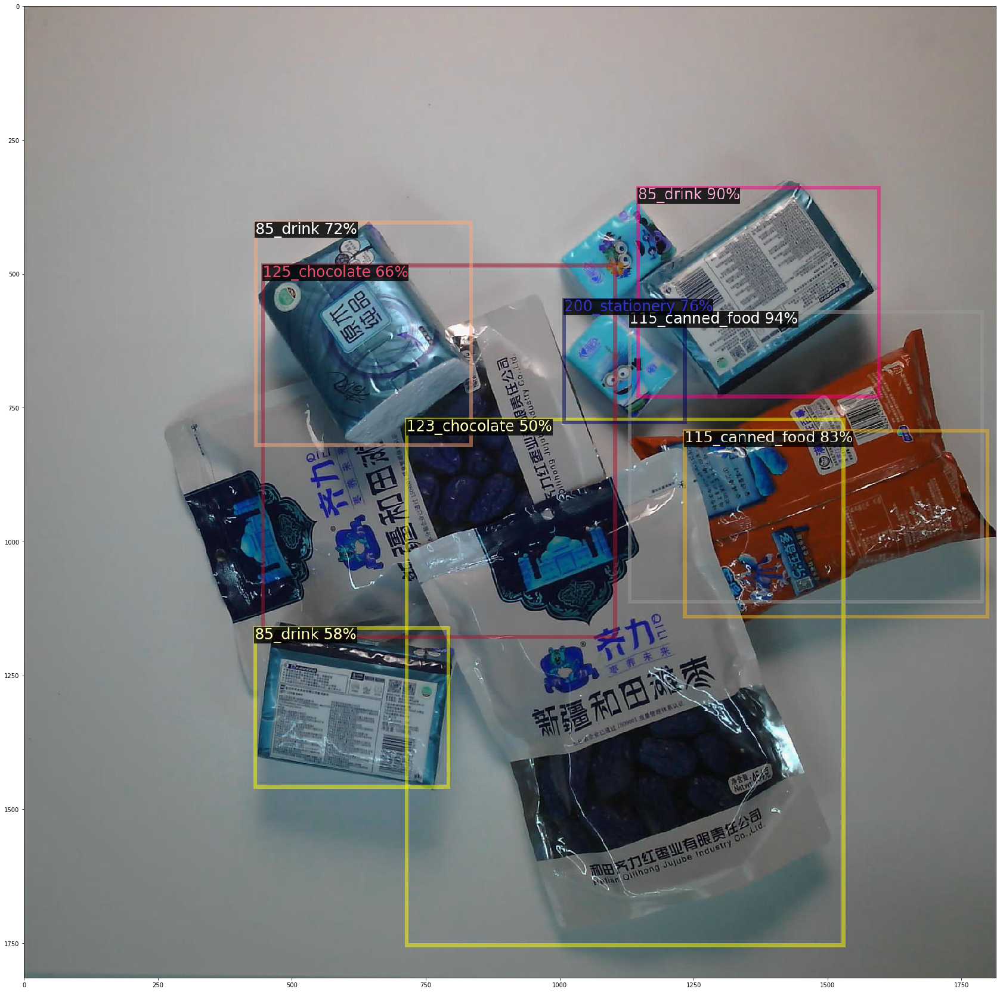

| Product Name    |   Quantity |
|-----------------+------------|
| 17_dried_fruit  |          2 |
| 184_tissue      |          3 |
| 112_canned_food |          1 |
| 28_dried_food   |          1 |
| 26_dried_food   |          1 |


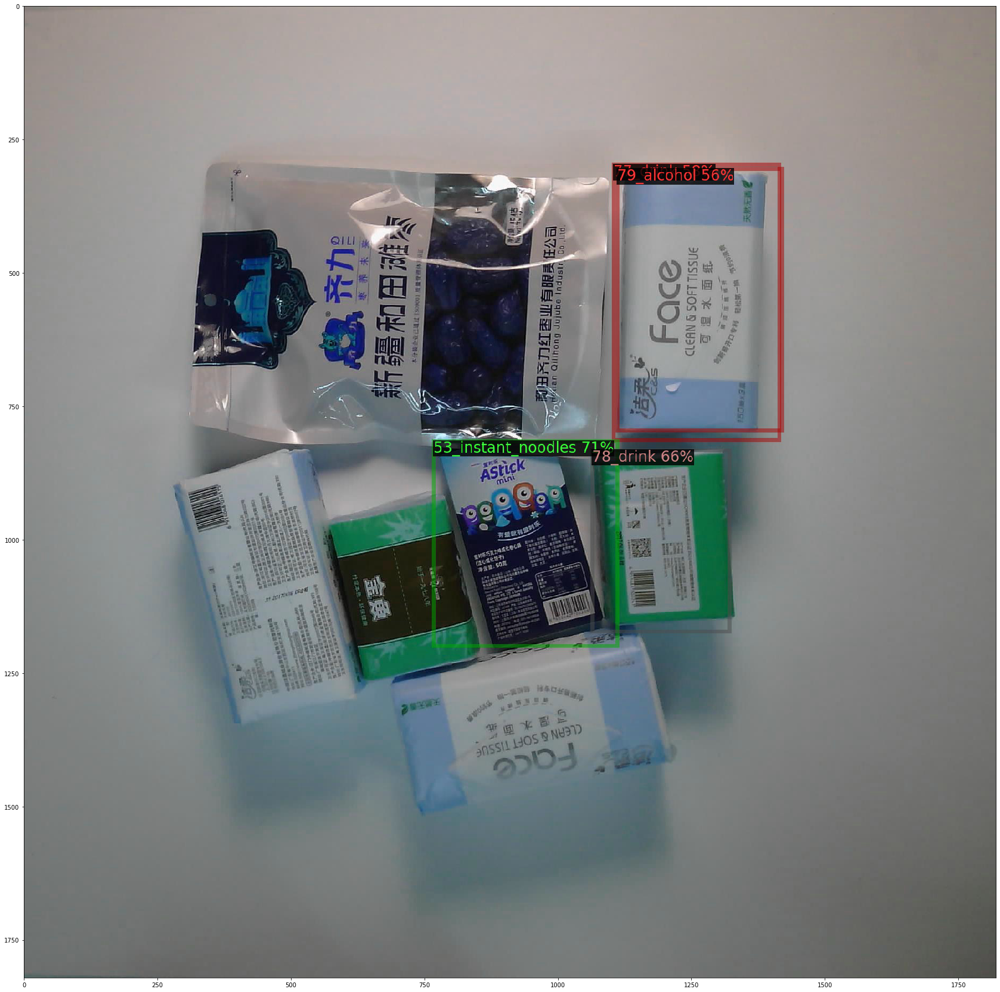

| Product Name   |   Quantity |
|----------------+------------|
| 149_candy      |          1 |
| 176_tissue     |          1 |
| 175_tissue     |          1 |
| 177_tissue     |          1 |


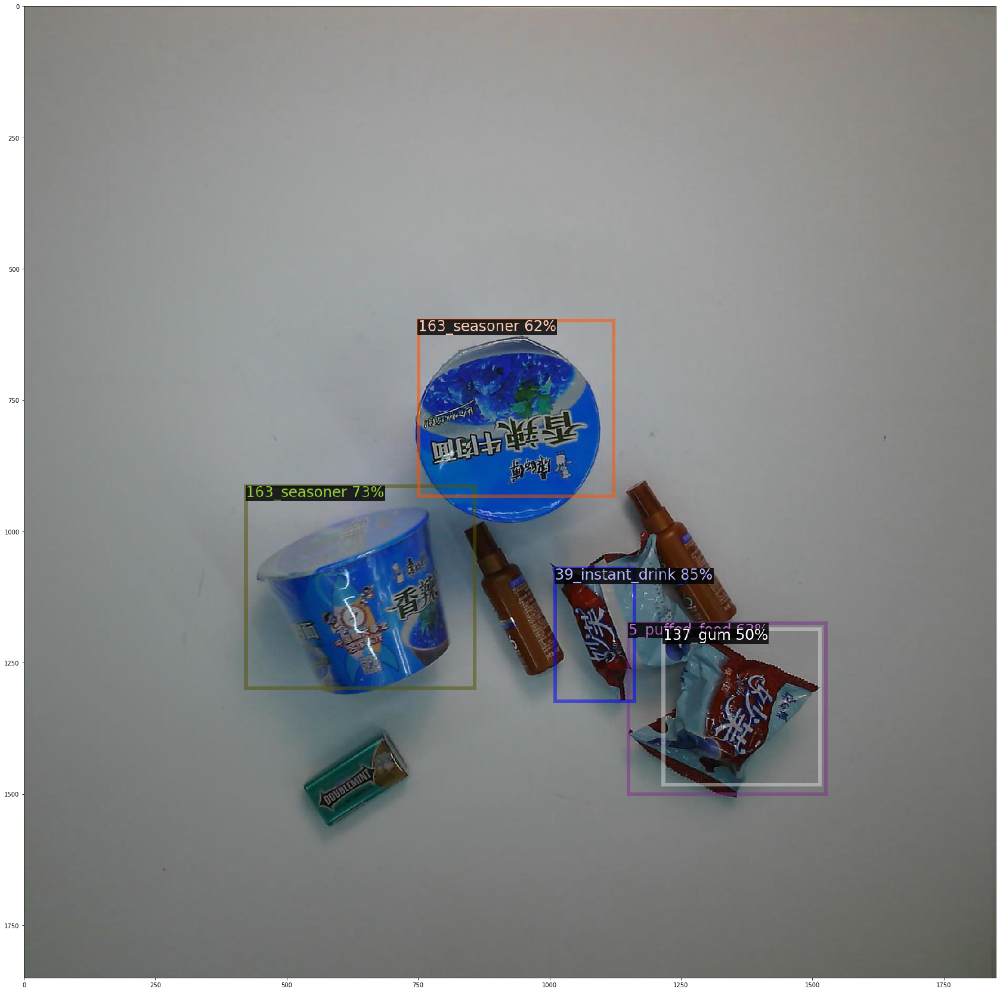

| Product Name     |   Quantity |
|------------------+------------|
| 133_chocolate    |          1 |
| 70_dessert       |          2 |
| 156_seasoner     |          1 |
| 41_instant_drink |          1 |


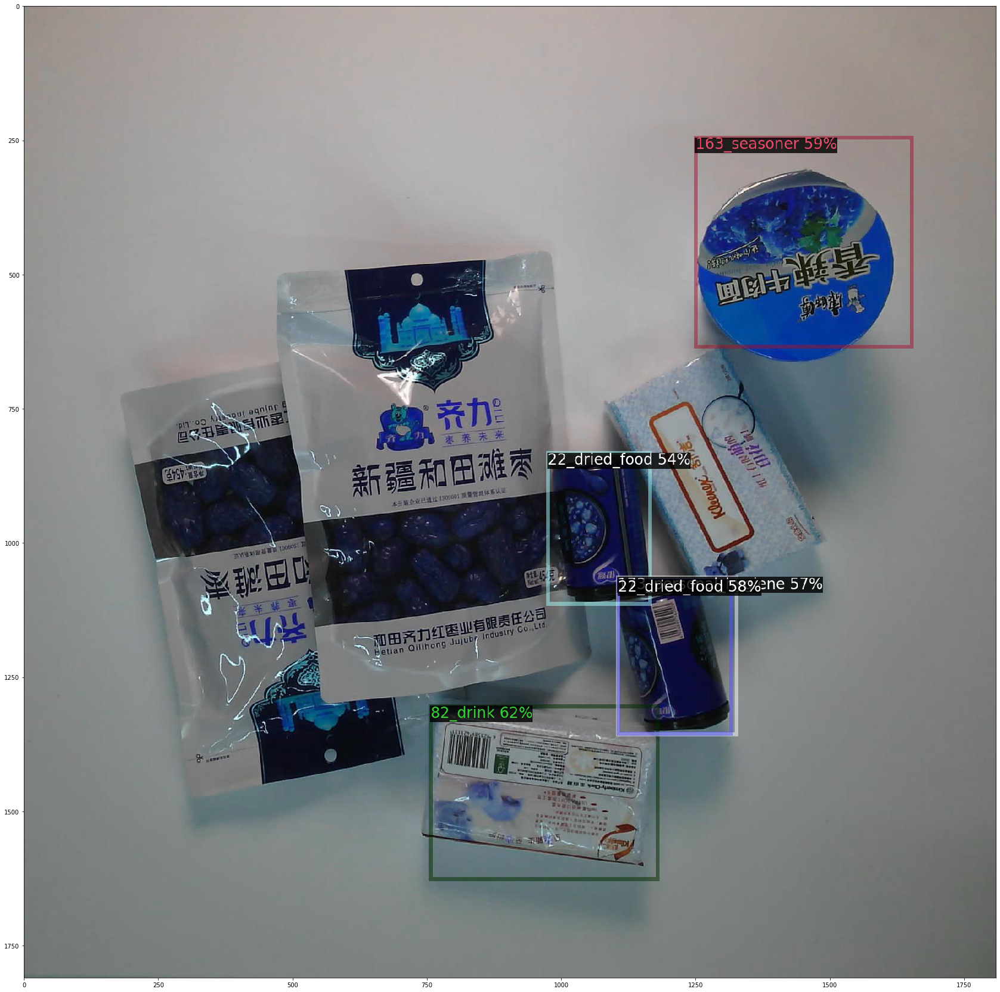

| Product Name    |   Quantity |
|-----------------+------------|
| 181_tissue      |          1 |
| 70_dessert      |          1 |
| 115_canned_food |          2 |
| 81_drink        |          1 |


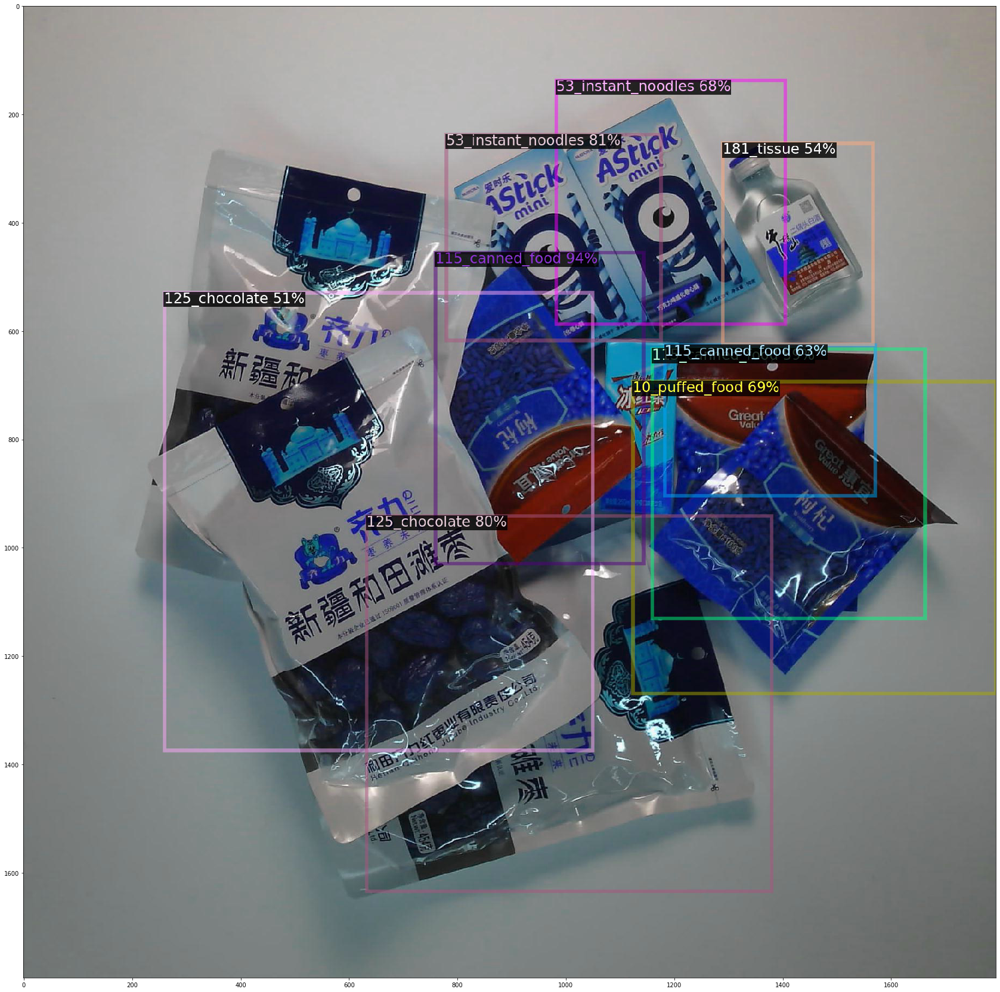

| Product Name   |   Quantity |
|----------------+------------|
| 17_dried_fruit |          3 |
| 149_candy      |          2 |
| 28_dried_food  |          2 |
| 11_puffed_food |          1 |
| 90_alcohol     |          1 |


In [58]:
# Getting inference using Sagemaker runtime.

import numpy as np
import boto3
from io import BytesIO
import re
from PIL import Image

bucket_name = 'retail-checkout-data'
runtime = boto3.client('sagemaker-runtime')

## Change the endpoint name accordingly
endpoint_name = "pytorch-inference-2020-08-03-11-36-13-857"     # Your endpoint name.

random.shuffle(images)

for img in images[:number_of_imgs]: 
    payload = '{"url":"'+img+'","products_list":"'+str(product_list)+'"}'
    response = runtime.invoke_endpoint(EndpointName=endpoint_name,
                                       ContentType=content_type,
                                       Accept = accept,
                                       Body=payload)
    data = BytesIO(response['Body'].read()).getvalue().decode('utf8')
    json_data = ast.literal_eval(data)
    image_name = img.strip().split('/')[-1]
    img_object = bucket.Object('results/'+image_name)
    response = img_object.get()
    file_stream = response['Body']
    image_data = np.array(Image.open(file_stream))
    plt.figure(figsize=(30,30))
    plt.imshow(image_data)
    plt.show()
    print_bill(json_data['result'])

### Deleting the endpoints in use

In [ ]:
import sagemaker

sagemaker.Session().delete_endpoint(predictor.endpoint)